<a href="https://colab.research.google.com/github/dmherrera/Tesis/blob/main/blendshapes_analyzer.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install -q mediapipe==0.10.0

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 33.9/33.9 MB 43.2 MB/s eta 0:00:00


In [ ]:
!wget -O face_landmarker_v2_with_blendshapes.task -q https://storage.googleapis.com/mediapipe-models/face_landmarker/face_landmarker/float16/1/face_landmarker.task

In [ ]:
#@markdown We implemented some functions to visualize the face landmark detection results. <br/> Run the following cell to activate the functions.

from mediapipe import solutions
from mediapipe.framework.formats import landmark_pb2
import numpy as np
import matplotlib.pyplot as plt


def draw_landmarks_on_image(rgb_image, detection_result):
  face_landmarks_list = detection_result.face_landmarks
  annotated_image = np.copy(rgb_image)

  # Loop through the detected faces to visualize.
  for idx in range(len(face_landmarks_list)):
    face_landmarks = face_landmarks_list[idx]

    # Draw the face landmarks.
    face_landmarks_proto = landmark_pb2.NormalizedLandmarkList()
    face_landmarks_proto.landmark.extend([
      landmark_pb2.NormalizedLandmark(x=landmark.x, y=landmark.y, z=landmark.z) for landmark in face_landmarks
    ])

    solutions.drawing_utils.draw_landmarks(
        image=annotated_image,
        landmark_list=face_landmarks_proto,
        connections=mp.solutions.face_mesh.FACEMESH_TESSELATION,
        landmark_drawing_spec=None,
        connection_drawing_spec=mp.solutions.drawing_styles
        .get_default_face_mesh_tesselation_style())
    solutions.drawing_utils.draw_landmarks(
        image=annotated_image,
        landmark_list=face_landmarks_proto,
        connections=mp.solutions.face_mesh.FACEMESH_CONTOURS,
        landmark_drawing_spec=None,
        connection_drawing_spec=mp.solutions.drawing_styles
        .get_default_face_mesh_contours_style())
    solutions.drawing_utils.draw_landmarks(
        image=annotated_image,
        landmark_list=face_landmarks_proto,
        connections=mp.solutions.face_mesh.FACEMESH_IRISES,
          landmark_drawing_spec=None,
          connection_drawing_spec=mp.solutions.drawing_styles
          .get_default_face_mesh_iris_connections_style())

  return annotated_image

#def plot_face_blendshapes_bar_graph(face_blendshapes):
  # Extract the face blendshapes category names and scores.
 # face_blendshapes_names = [face_blendshapes_category.category_name for face_blendshapes_category in face_blendshapes]
#  face_blendshapes_scores = [face_blendshapes_category.score for face_blendshapes_category in face_blendshapes]
  # The blendshapes are ordered in decreasing score value.
#  face_blendshapes_ranks = range(len(face_blendshapes_names))

#  fig, ax = plt.subplots(figsize=(12, 12))
 # bar = ax.barh(face_blendshapes_ranks, face_blendshapes_scores, label=[str(x) for x in face_blendshapes_ranks])
#  ax.set_yticks(face_blendshapes_ranks, face_blendshapes_names)
#  ax.invert_yaxis()

  # Label each bar with values
#  for score, patch in zip(face_blendshapes_scores, bar.patches):
#    plt.text(patch.get_x() + patch.get_width(), patch.get_y(), f"{score:.4f}", va="top")

#  ax.set_xlabel('Score')
#  ax.set_title("Face Blendshapes")
#  plt.tight_layout()
 # plt.show()

Get image

In [ ]:
import cv2
from google.colab.patches import cv2_imshow



In [ ]:
#Upload image from Device //figure out how to loop? maybe?

from google.colab import files
uploaded = files.upload()

for filename in uploaded:
   content = uploaded[filename]
   with open(filename, 'wb') as f:
     f.write(content)

if len(uploaded.keys()):
   IMAGE_FILE = next(iter(uploaded))
   print('Uploaded file:', IMAGE_FILE)

Saving 920.jpg to 920.jpg
Uploaded file: 920.jpg


In [ ]:
#images in folder iteration

import os
from os import listdir

# get the path/directory
folder_dir = "/content/sad"
for image in os.listdir(folder_dir):

    # check if the image ends with png
    if (image.endswith(".png")):
        print(image)

#Run face landmark detection using MediaPipe.

In [ ]:
# STEP 1: Import the necessary modules.
import mediapipe as mp
from mediapipe.tasks import python
from mediapipe.tasks.python import vision
import cv2
from google.colab.patches import cv2_imshow
import os
from os import listdir

# STEP 2: Create an FaceLandmarker object.
base_options = python.BaseOptions(model_asset_path='face_landmarker_v2_with_blendshapes.task')
options = vision.FaceLandmarkerOptions(base_options=base_options,
                                       output_face_blendshapes=True,
                                       output_facial_transformation_matrixes=True,
                                       num_faces=1)
detector = vision.FaceLandmarker.create_from_options(options)

#initialize once
fear = {}



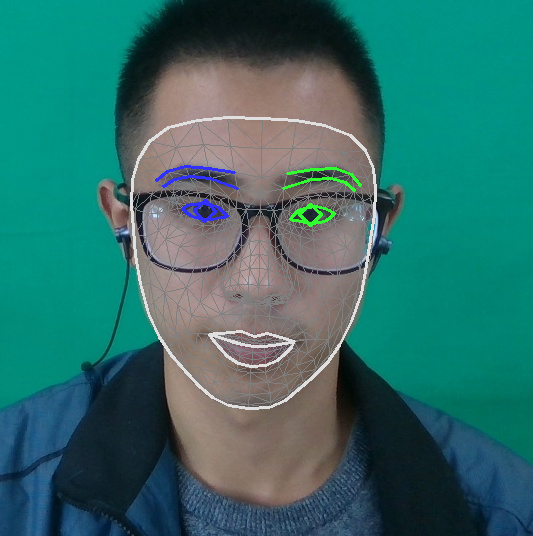

{'img9.jpg': {'browInnerUp': 0.1716793179512024, 'browOuterUpLeft': 0.13236746191978455, 'eyeLookDownLeft': 0.14801891148090363, 'eyeLookDownRight': 0.14949549734592438, 'eyeSquintLeft': 0.4661008417606354, 'eyeSquintRight': 0.36919909715652466, 'mouthPressRight': 0.12983199954032898}}


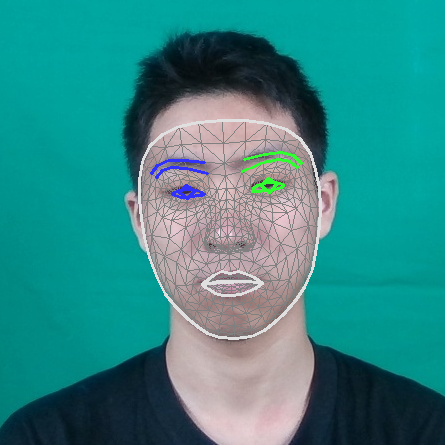

{'img9.jpg': {'browInnerUp': 0.1716793179512024, 'browOuterUpLeft': 0.13236746191978455, 'eyeLookDownLeft': 0.14801891148090363, 'eyeLookDownRight': 0.14949549734592438, 'eyeSquintLeft': 0.4661008417606354, 'eyeSquintRight': 0.36919909715652466, 'mouthPressRight': 0.12983199954032898}, 'img744.jpg': {'browInnerUp': 0.1004304587841034, 'browOuterUpLeft': 0.20178279280662537, 'browOuterUpRight': 0.1044047549366951, 'eyeBlinkLeft': 0.2302534580230713, 'eyeBlinkRight': 0.32938116788864136, 'eyeLookDownRight': 0.10570868849754333, 'eyeLookInRight': 0.19828230142593384, 'eyeLookOutLeft': 0.20405025780200958, 'eyeLookUpLeft': 0.1273510456085205, 'eyeLookUpRight': 0.1056172177195549, 'eyeSquintLeft': 0.6309655904769897, 'eyeSquintRight': 0.40485402941703796, 'mouthPucker': 0.38343706727027893}}


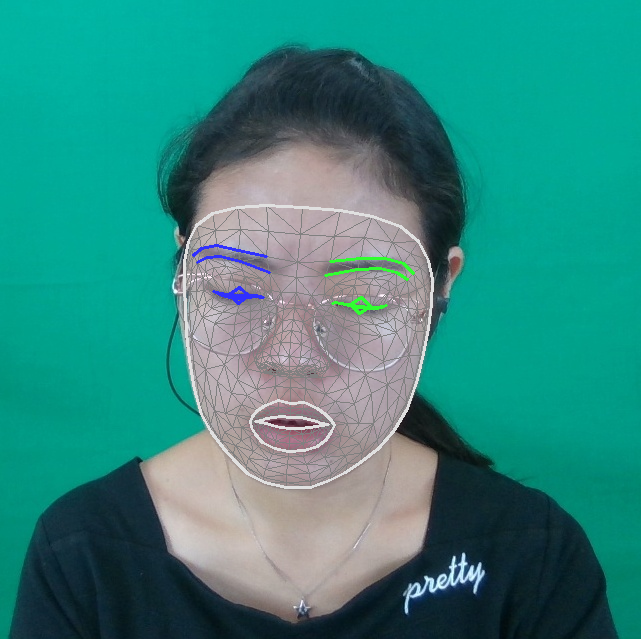

{'img9.jpg': {'browInnerUp': 0.1716793179512024, 'browOuterUpLeft': 0.13236746191978455, 'eyeLookDownLeft': 0.14801891148090363, 'eyeLookDownRight': 0.14949549734592438, 'eyeSquintLeft': 0.4661008417606354, 'eyeSquintRight': 0.36919909715652466, 'mouthPressRight': 0.12983199954032898}, 'img744.jpg': {'browInnerUp': 0.1004304587841034, 'browOuterUpLeft': 0.20178279280662537, 'browOuterUpRight': 0.1044047549366951, 'eyeBlinkLeft': 0.2302534580230713, 'eyeBlinkRight': 0.32938116788864136, 'eyeLookDownRight': 0.10570868849754333, 'eyeLookInRight': 0.19828230142593384, 'eyeLookOutLeft': 0.20405025780200958, 'eyeLookUpLeft': 0.1273510456085205, 'eyeLookUpRight': 0.1056172177195549, 'eyeSquintLeft': 0.6309655904769897, 'eyeSquintRight': 0.40485402941703796, 'mouthPucker': 0.38343706727027893}, 'img2222.jpg': {'browOuterUpLeft': 0.2936858534812927, 'browOuterUpRight': 0.18468357622623444, 'eyeBlinkLeft': 0.6929765343666077, 'eyeBlinkRight': 0.5651941299438477, 'eyeLookDownLeft': 0.712114930152

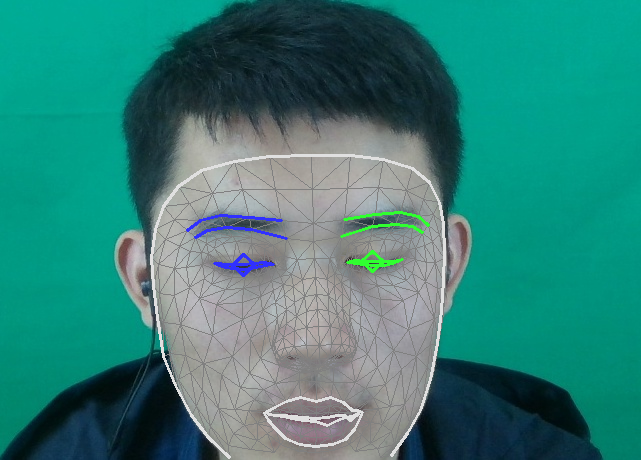

{'img9.jpg': {'browInnerUp': 0.1716793179512024, 'browOuterUpLeft': 0.13236746191978455, 'eyeLookDownLeft': 0.14801891148090363, 'eyeLookDownRight': 0.14949549734592438, 'eyeSquintLeft': 0.4661008417606354, 'eyeSquintRight': 0.36919909715652466, 'mouthPressRight': 0.12983199954032898}, 'img744.jpg': {'browInnerUp': 0.1004304587841034, 'browOuterUpLeft': 0.20178279280662537, 'browOuterUpRight': 0.1044047549366951, 'eyeBlinkLeft': 0.2302534580230713, 'eyeBlinkRight': 0.32938116788864136, 'eyeLookDownRight': 0.10570868849754333, 'eyeLookInRight': 0.19828230142593384, 'eyeLookOutLeft': 0.20405025780200958, 'eyeLookUpLeft': 0.1273510456085205, 'eyeLookUpRight': 0.1056172177195549, 'eyeSquintLeft': 0.6309655904769897, 'eyeSquintRight': 0.40485402941703796, 'mouthPucker': 0.38343706727027893}, 'img2222.jpg': {'browOuterUpLeft': 0.2936858534812927, 'browOuterUpRight': 0.18468357622623444, 'eyeBlinkLeft': 0.6929765343666077, 'eyeBlinkRight': 0.5651941299438477, 'eyeLookDownLeft': 0.712114930152

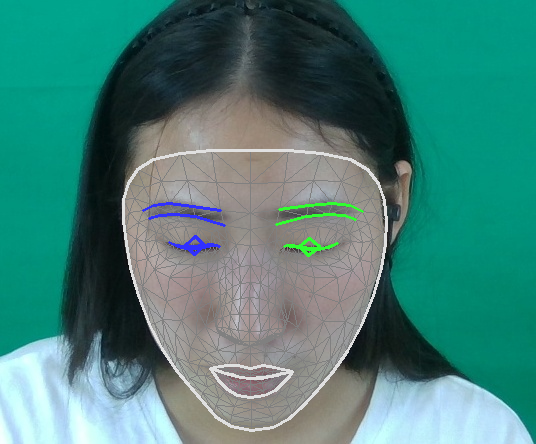

{'img9.jpg': {'browInnerUp': 0.1716793179512024, 'browOuterUpLeft': 0.13236746191978455, 'eyeLookDownLeft': 0.14801891148090363, 'eyeLookDownRight': 0.14949549734592438, 'eyeSquintLeft': 0.4661008417606354, 'eyeSquintRight': 0.36919909715652466, 'mouthPressRight': 0.12983199954032898}, 'img744.jpg': {'browInnerUp': 0.1004304587841034, 'browOuterUpLeft': 0.20178279280662537, 'browOuterUpRight': 0.1044047549366951, 'eyeBlinkLeft': 0.2302534580230713, 'eyeBlinkRight': 0.32938116788864136, 'eyeLookDownRight': 0.10570868849754333, 'eyeLookInRight': 0.19828230142593384, 'eyeLookOutLeft': 0.20405025780200958, 'eyeLookUpLeft': 0.1273510456085205, 'eyeLookUpRight': 0.1056172177195549, 'eyeSquintLeft': 0.6309655904769897, 'eyeSquintRight': 0.40485402941703796, 'mouthPucker': 0.38343706727027893}, 'img2222.jpg': {'browOuterUpLeft': 0.2936858534812927, 'browOuterUpRight': 0.18468357622623444, 'eyeBlinkLeft': 0.6929765343666077, 'eyeBlinkRight': 0.5651941299438477, 'eyeLookDownLeft': 0.712114930152

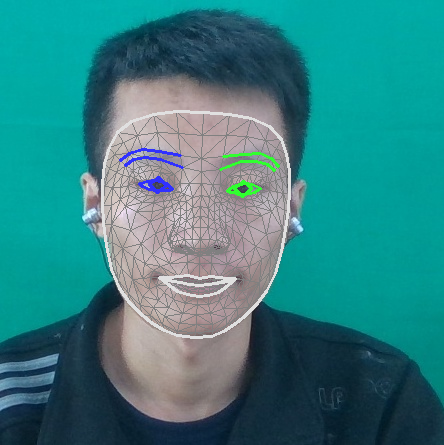

{'img9.jpg': {'browInnerUp': 0.1716793179512024, 'browOuterUpLeft': 0.13236746191978455, 'eyeLookDownLeft': 0.14801891148090363, 'eyeLookDownRight': 0.14949549734592438, 'eyeSquintLeft': 0.4661008417606354, 'eyeSquintRight': 0.36919909715652466, 'mouthPressRight': 0.12983199954032898}, 'img744.jpg': {'browInnerUp': 0.1004304587841034, 'browOuterUpLeft': 0.20178279280662537, 'browOuterUpRight': 0.1044047549366951, 'eyeBlinkLeft': 0.2302534580230713, 'eyeBlinkRight': 0.32938116788864136, 'eyeLookDownRight': 0.10570868849754333, 'eyeLookInRight': 0.19828230142593384, 'eyeLookOutLeft': 0.20405025780200958, 'eyeLookUpLeft': 0.1273510456085205, 'eyeLookUpRight': 0.1056172177195549, 'eyeSquintLeft': 0.6309655904769897, 'eyeSquintRight': 0.40485402941703796, 'mouthPucker': 0.38343706727027893}, 'img2222.jpg': {'browOuterUpLeft': 0.2936858534812927, 'browOuterUpRight': 0.18468357622623444, 'eyeBlinkLeft': 0.6929765343666077, 'eyeBlinkRight': 0.5651941299438477, 'eyeLookDownLeft': 0.712114930152

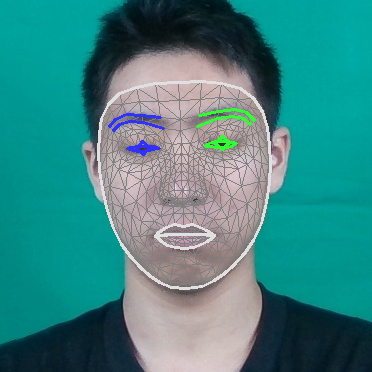

{'img9.jpg': {'browInnerUp': 0.1716793179512024, 'browOuterUpLeft': 0.13236746191978455, 'eyeLookDownLeft': 0.14801891148090363, 'eyeLookDownRight': 0.14949549734592438, 'eyeSquintLeft': 0.4661008417606354, 'eyeSquintRight': 0.36919909715652466, 'mouthPressRight': 0.12983199954032898}, 'img744.jpg': {'browInnerUp': 0.1004304587841034, 'browOuterUpLeft': 0.20178279280662537, 'browOuterUpRight': 0.1044047549366951, 'eyeBlinkLeft': 0.2302534580230713, 'eyeBlinkRight': 0.32938116788864136, 'eyeLookDownRight': 0.10570868849754333, 'eyeLookInRight': 0.19828230142593384, 'eyeLookOutLeft': 0.20405025780200958, 'eyeLookUpLeft': 0.1273510456085205, 'eyeLookUpRight': 0.1056172177195549, 'eyeSquintLeft': 0.6309655904769897, 'eyeSquintRight': 0.40485402941703796, 'mouthPucker': 0.38343706727027893}, 'img2222.jpg': {'browOuterUpLeft': 0.2936858534812927, 'browOuterUpRight': 0.18468357622623444, 'eyeBlinkLeft': 0.6929765343666077, 'eyeBlinkRight': 0.5651941299438477, 'eyeLookDownLeft': 0.712114930152

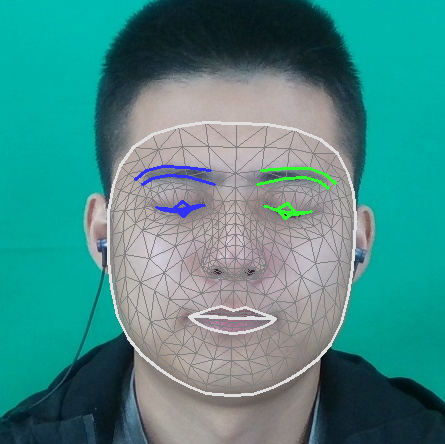

{'img9.jpg': {'browInnerUp': 0.1716793179512024, 'browOuterUpLeft': 0.13236746191978455, 'eyeLookDownLeft': 0.14801891148090363, 'eyeLookDownRight': 0.14949549734592438, 'eyeSquintLeft': 0.4661008417606354, 'eyeSquintRight': 0.36919909715652466, 'mouthPressRight': 0.12983199954032898}, 'img744.jpg': {'browInnerUp': 0.1004304587841034, 'browOuterUpLeft': 0.20178279280662537, 'browOuterUpRight': 0.1044047549366951, 'eyeBlinkLeft': 0.2302534580230713, 'eyeBlinkRight': 0.32938116788864136, 'eyeLookDownRight': 0.10570868849754333, 'eyeLookInRight': 0.19828230142593384, 'eyeLookOutLeft': 0.20405025780200958, 'eyeLookUpLeft': 0.1273510456085205, 'eyeLookUpRight': 0.1056172177195549, 'eyeSquintLeft': 0.6309655904769897, 'eyeSquintRight': 0.40485402941703796, 'mouthPucker': 0.38343706727027893}, 'img2222.jpg': {'browOuterUpLeft': 0.2936858534812927, 'browOuterUpRight': 0.18468357622623444, 'eyeBlinkLeft': 0.6929765343666077, 'eyeBlinkRight': 0.5651941299438477, 'eyeLookDownLeft': 0.712114930152

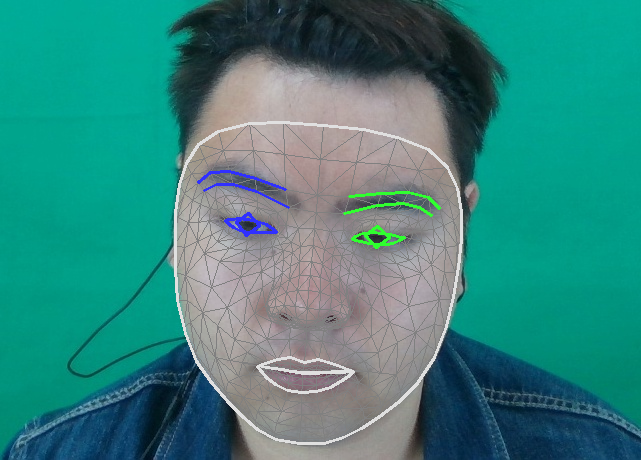

{'img9.jpg': {'browInnerUp': 0.1716793179512024, 'browOuterUpLeft': 0.13236746191978455, 'eyeLookDownLeft': 0.14801891148090363, 'eyeLookDownRight': 0.14949549734592438, 'eyeSquintLeft': 0.4661008417606354, 'eyeSquintRight': 0.36919909715652466, 'mouthPressRight': 0.12983199954032898}, 'img744.jpg': {'browInnerUp': 0.1004304587841034, 'browOuterUpLeft': 0.20178279280662537, 'browOuterUpRight': 0.1044047549366951, 'eyeBlinkLeft': 0.2302534580230713, 'eyeBlinkRight': 0.32938116788864136, 'eyeLookDownRight': 0.10570868849754333, 'eyeLookInRight': 0.19828230142593384, 'eyeLookOutLeft': 0.20405025780200958, 'eyeLookUpLeft': 0.1273510456085205, 'eyeLookUpRight': 0.1056172177195549, 'eyeSquintLeft': 0.6309655904769897, 'eyeSquintRight': 0.40485402941703796, 'mouthPucker': 0.38343706727027893}, 'img2222.jpg': {'browOuterUpLeft': 0.2936858534812927, 'browOuterUpRight': 0.18468357622623444, 'eyeBlinkLeft': 0.6929765343666077, 'eyeBlinkRight': 0.5651941299438477, 'eyeLookDownLeft': 0.712114930152

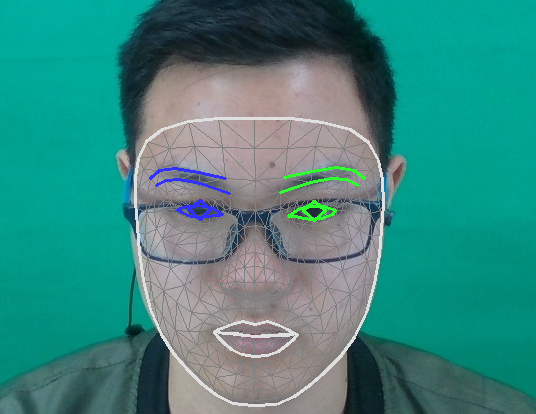

{'img9.jpg': {'browInnerUp': 0.1716793179512024, 'browOuterUpLeft': 0.13236746191978455, 'eyeLookDownLeft': 0.14801891148090363, 'eyeLookDownRight': 0.14949549734592438, 'eyeSquintLeft': 0.4661008417606354, 'eyeSquintRight': 0.36919909715652466, 'mouthPressRight': 0.12983199954032898}, 'img744.jpg': {'browInnerUp': 0.1004304587841034, 'browOuterUpLeft': 0.20178279280662537, 'browOuterUpRight': 0.1044047549366951, 'eyeBlinkLeft': 0.2302534580230713, 'eyeBlinkRight': 0.32938116788864136, 'eyeLookDownRight': 0.10570868849754333, 'eyeLookInRight': 0.19828230142593384, 'eyeLookOutLeft': 0.20405025780200958, 'eyeLookUpLeft': 0.1273510456085205, 'eyeLookUpRight': 0.1056172177195549, 'eyeSquintLeft': 0.6309655904769897, 'eyeSquintRight': 0.40485402941703796, 'mouthPucker': 0.38343706727027893}, 'img2222.jpg': {'browOuterUpLeft': 0.2936858534812927, 'browOuterUpRight': 0.18468357622623444, 'eyeBlinkLeft': 0.6929765343666077, 'eyeBlinkRight': 0.5651941299438477, 'eyeLookDownLeft': 0.712114930152

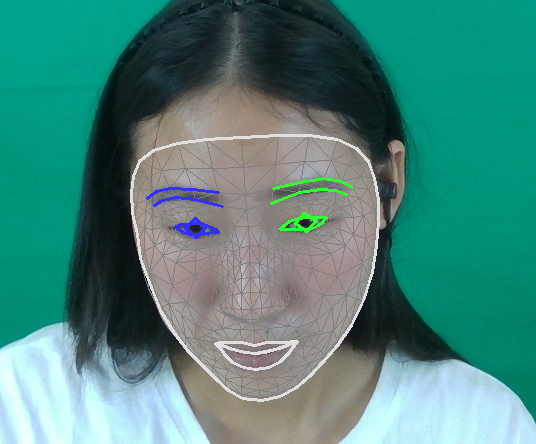

{'img9.jpg': {'browInnerUp': 0.1716793179512024, 'browOuterUpLeft': 0.13236746191978455, 'eyeLookDownLeft': 0.14801891148090363, 'eyeLookDownRight': 0.14949549734592438, 'eyeSquintLeft': 0.4661008417606354, 'eyeSquintRight': 0.36919909715652466, 'mouthPressRight': 0.12983199954032898}, 'img744.jpg': {'browInnerUp': 0.1004304587841034, 'browOuterUpLeft': 0.20178279280662537, 'browOuterUpRight': 0.1044047549366951, 'eyeBlinkLeft': 0.2302534580230713, 'eyeBlinkRight': 0.32938116788864136, 'eyeLookDownRight': 0.10570868849754333, 'eyeLookInRight': 0.19828230142593384, 'eyeLookOutLeft': 0.20405025780200958, 'eyeLookUpLeft': 0.1273510456085205, 'eyeLookUpRight': 0.1056172177195549, 'eyeSquintLeft': 0.6309655904769897, 'eyeSquintRight': 0.40485402941703796, 'mouthPucker': 0.38343706727027893}, 'img2222.jpg': {'browOuterUpLeft': 0.2936858534812927, 'browOuterUpRight': 0.18468357622623444, 'eyeBlinkLeft': 0.6929765343666077, 'eyeBlinkRight': 0.5651941299438477, 'eyeLookDownLeft': 0.712114930152

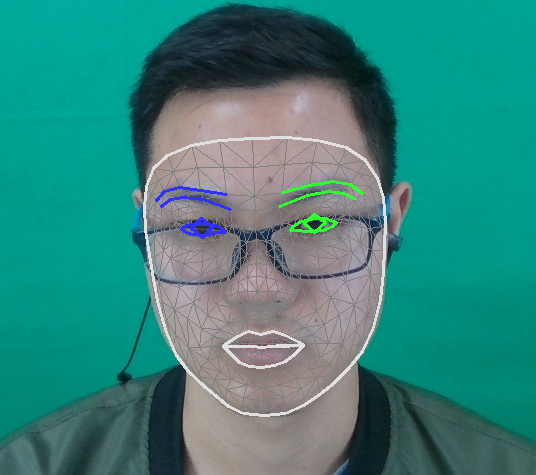

{'img9.jpg': {'browInnerUp': 0.1716793179512024, 'browOuterUpLeft': 0.13236746191978455, 'eyeLookDownLeft': 0.14801891148090363, 'eyeLookDownRight': 0.14949549734592438, 'eyeSquintLeft': 0.4661008417606354, 'eyeSquintRight': 0.36919909715652466, 'mouthPressRight': 0.12983199954032898}, 'img744.jpg': {'browInnerUp': 0.1004304587841034, 'browOuterUpLeft': 0.20178279280662537, 'browOuterUpRight': 0.1044047549366951, 'eyeBlinkLeft': 0.2302534580230713, 'eyeBlinkRight': 0.32938116788864136, 'eyeLookDownRight': 0.10570868849754333, 'eyeLookInRight': 0.19828230142593384, 'eyeLookOutLeft': 0.20405025780200958, 'eyeLookUpLeft': 0.1273510456085205, 'eyeLookUpRight': 0.1056172177195549, 'eyeSquintLeft': 0.6309655904769897, 'eyeSquintRight': 0.40485402941703796, 'mouthPucker': 0.38343706727027893}, 'img2222.jpg': {'browOuterUpLeft': 0.2936858534812927, 'browOuterUpRight': 0.18468357622623444, 'eyeBlinkLeft': 0.6929765343666077, 'eyeBlinkRight': 0.5651941299438477, 'eyeLookDownLeft': 0.712114930152

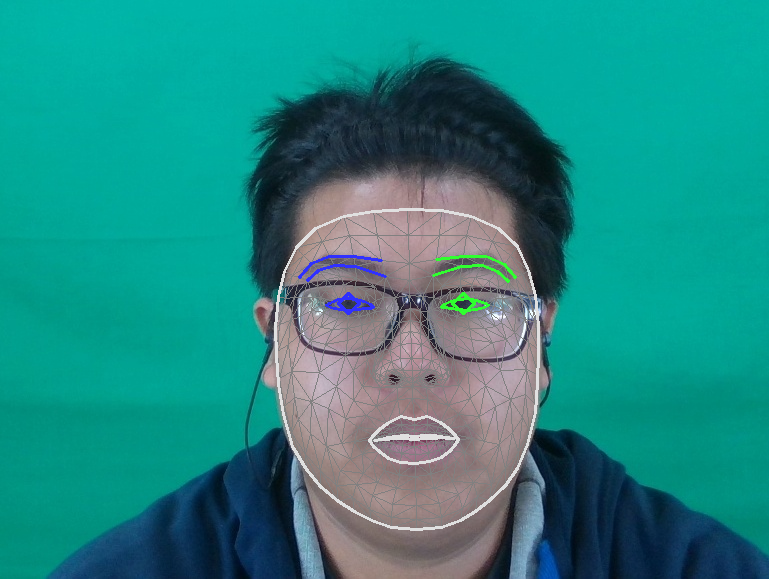

{'img9.jpg': {'browInnerUp': 0.1716793179512024, 'browOuterUpLeft': 0.13236746191978455, 'eyeLookDownLeft': 0.14801891148090363, 'eyeLookDownRight': 0.14949549734592438, 'eyeSquintLeft': 0.4661008417606354, 'eyeSquintRight': 0.36919909715652466, 'mouthPressRight': 0.12983199954032898}, 'img744.jpg': {'browInnerUp': 0.1004304587841034, 'browOuterUpLeft': 0.20178279280662537, 'browOuterUpRight': 0.1044047549366951, 'eyeBlinkLeft': 0.2302534580230713, 'eyeBlinkRight': 0.32938116788864136, 'eyeLookDownRight': 0.10570868849754333, 'eyeLookInRight': 0.19828230142593384, 'eyeLookOutLeft': 0.20405025780200958, 'eyeLookUpLeft': 0.1273510456085205, 'eyeLookUpRight': 0.1056172177195549, 'eyeSquintLeft': 0.6309655904769897, 'eyeSquintRight': 0.40485402941703796, 'mouthPucker': 0.38343706727027893}, 'img2222.jpg': {'browOuterUpLeft': 0.2936858534812927, 'browOuterUpRight': 0.18468357622623444, 'eyeBlinkLeft': 0.6929765343666077, 'eyeBlinkRight': 0.5651941299438477, 'eyeLookDownLeft': 0.712114930152

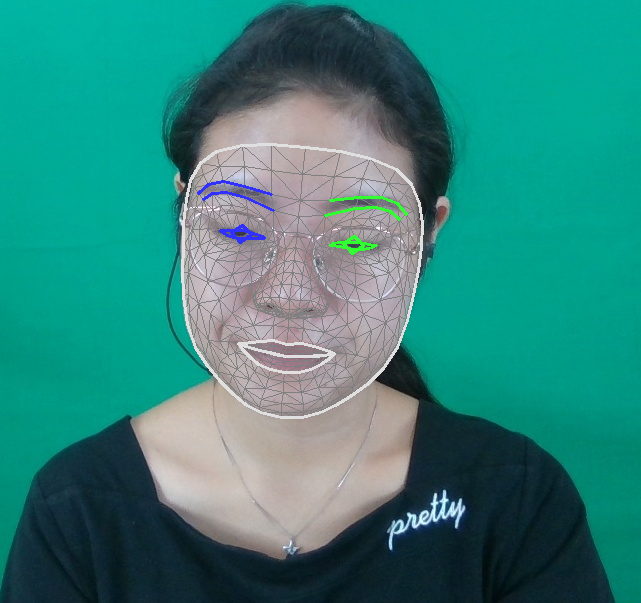

{'img9.jpg': {'browInnerUp': 0.1716793179512024, 'browOuterUpLeft': 0.13236746191978455, 'eyeLookDownLeft': 0.14801891148090363, 'eyeLookDownRight': 0.14949549734592438, 'eyeSquintLeft': 0.4661008417606354, 'eyeSquintRight': 0.36919909715652466, 'mouthPressRight': 0.12983199954032898}, 'img744.jpg': {'browInnerUp': 0.1004304587841034, 'browOuterUpLeft': 0.20178279280662537, 'browOuterUpRight': 0.1044047549366951, 'eyeBlinkLeft': 0.2302534580230713, 'eyeBlinkRight': 0.32938116788864136, 'eyeLookDownRight': 0.10570868849754333, 'eyeLookInRight': 0.19828230142593384, 'eyeLookOutLeft': 0.20405025780200958, 'eyeLookUpLeft': 0.1273510456085205, 'eyeLookUpRight': 0.1056172177195549, 'eyeSquintLeft': 0.6309655904769897, 'eyeSquintRight': 0.40485402941703796, 'mouthPucker': 0.38343706727027893}, 'img2222.jpg': {'browOuterUpLeft': 0.2936858534812927, 'browOuterUpRight': 0.18468357622623444, 'eyeBlinkLeft': 0.6929765343666077, 'eyeBlinkRight': 0.5651941299438477, 'eyeLookDownLeft': 0.712114930152

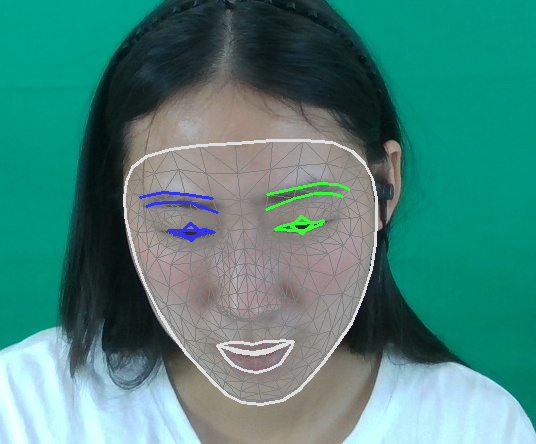

{'img9.jpg': {'browInnerUp': 0.1716793179512024, 'browOuterUpLeft': 0.13236746191978455, 'eyeLookDownLeft': 0.14801891148090363, 'eyeLookDownRight': 0.14949549734592438, 'eyeSquintLeft': 0.4661008417606354, 'eyeSquintRight': 0.36919909715652466, 'mouthPressRight': 0.12983199954032898}, 'img744.jpg': {'browInnerUp': 0.1004304587841034, 'browOuterUpLeft': 0.20178279280662537, 'browOuterUpRight': 0.1044047549366951, 'eyeBlinkLeft': 0.2302534580230713, 'eyeBlinkRight': 0.32938116788864136, 'eyeLookDownRight': 0.10570868849754333, 'eyeLookInRight': 0.19828230142593384, 'eyeLookOutLeft': 0.20405025780200958, 'eyeLookUpLeft': 0.1273510456085205, 'eyeLookUpRight': 0.1056172177195549, 'eyeSquintLeft': 0.6309655904769897, 'eyeSquintRight': 0.40485402941703796, 'mouthPucker': 0.38343706727027893}, 'img2222.jpg': {'browOuterUpLeft': 0.2936858534812927, 'browOuterUpRight': 0.18468357622623444, 'eyeBlinkLeft': 0.6929765343666077, 'eyeBlinkRight': 0.5651941299438477, 'eyeLookDownLeft': 0.712114930152

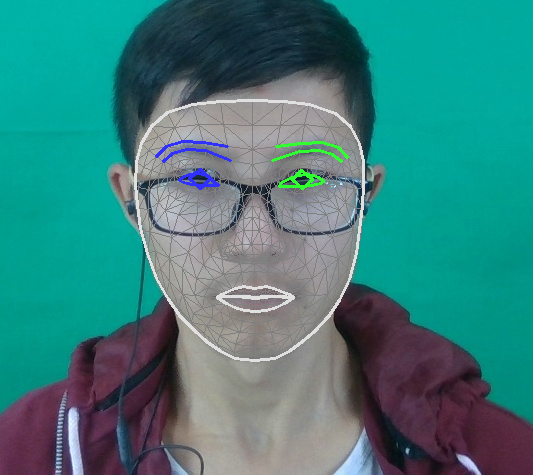

{'img9.jpg': {'browInnerUp': 0.1716793179512024, 'browOuterUpLeft': 0.13236746191978455, 'eyeLookDownLeft': 0.14801891148090363, 'eyeLookDownRight': 0.14949549734592438, 'eyeSquintLeft': 0.4661008417606354, 'eyeSquintRight': 0.36919909715652466, 'mouthPressRight': 0.12983199954032898}, 'img744.jpg': {'browInnerUp': 0.1004304587841034, 'browOuterUpLeft': 0.20178279280662537, 'browOuterUpRight': 0.1044047549366951, 'eyeBlinkLeft': 0.2302534580230713, 'eyeBlinkRight': 0.32938116788864136, 'eyeLookDownRight': 0.10570868849754333, 'eyeLookInRight': 0.19828230142593384, 'eyeLookOutLeft': 0.20405025780200958, 'eyeLookUpLeft': 0.1273510456085205, 'eyeLookUpRight': 0.1056172177195549, 'eyeSquintLeft': 0.6309655904769897, 'eyeSquintRight': 0.40485402941703796, 'mouthPucker': 0.38343706727027893}, 'img2222.jpg': {'browOuterUpLeft': 0.2936858534812927, 'browOuterUpRight': 0.18468357622623444, 'eyeBlinkLeft': 0.6929765343666077, 'eyeBlinkRight': 0.5651941299438477, 'eyeLookDownLeft': 0.712114930152

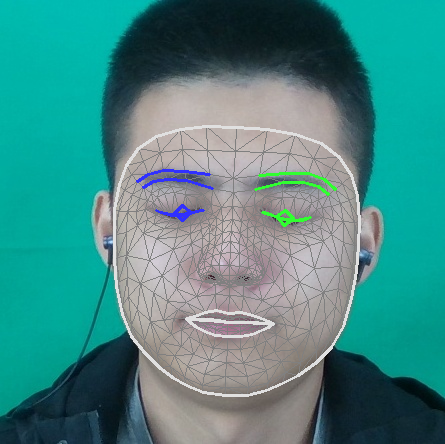

{'img9.jpg': {'browInnerUp': 0.1716793179512024, 'browOuterUpLeft': 0.13236746191978455, 'eyeLookDownLeft': 0.14801891148090363, 'eyeLookDownRight': 0.14949549734592438, 'eyeSquintLeft': 0.4661008417606354, 'eyeSquintRight': 0.36919909715652466, 'mouthPressRight': 0.12983199954032898}, 'img744.jpg': {'browInnerUp': 0.1004304587841034, 'browOuterUpLeft': 0.20178279280662537, 'browOuterUpRight': 0.1044047549366951, 'eyeBlinkLeft': 0.2302534580230713, 'eyeBlinkRight': 0.32938116788864136, 'eyeLookDownRight': 0.10570868849754333, 'eyeLookInRight': 0.19828230142593384, 'eyeLookOutLeft': 0.20405025780200958, 'eyeLookUpLeft': 0.1273510456085205, 'eyeLookUpRight': 0.1056172177195549, 'eyeSquintLeft': 0.6309655904769897, 'eyeSquintRight': 0.40485402941703796, 'mouthPucker': 0.38343706727027893}, 'img2222.jpg': {'browOuterUpLeft': 0.2936858534812927, 'browOuterUpRight': 0.18468357622623444, 'eyeBlinkLeft': 0.6929765343666077, 'eyeBlinkRight': 0.5651941299438477, 'eyeLookDownLeft': 0.712114930152

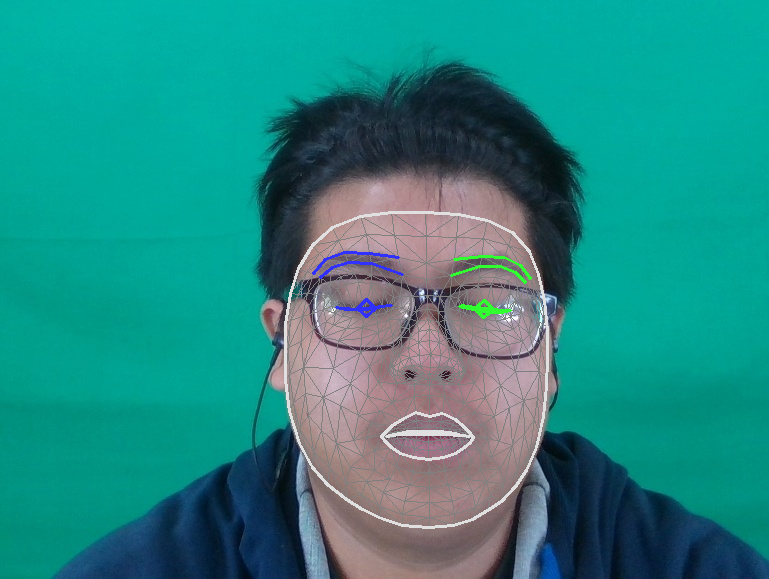

{'img9.jpg': {'browInnerUp': 0.1716793179512024, 'browOuterUpLeft': 0.13236746191978455, 'eyeLookDownLeft': 0.14801891148090363, 'eyeLookDownRight': 0.14949549734592438, 'eyeSquintLeft': 0.4661008417606354, 'eyeSquintRight': 0.36919909715652466, 'mouthPressRight': 0.12983199954032898}, 'img744.jpg': {'browInnerUp': 0.1004304587841034, 'browOuterUpLeft': 0.20178279280662537, 'browOuterUpRight': 0.1044047549366951, 'eyeBlinkLeft': 0.2302534580230713, 'eyeBlinkRight': 0.32938116788864136, 'eyeLookDownRight': 0.10570868849754333, 'eyeLookInRight': 0.19828230142593384, 'eyeLookOutLeft': 0.20405025780200958, 'eyeLookUpLeft': 0.1273510456085205, 'eyeLookUpRight': 0.1056172177195549, 'eyeSquintLeft': 0.6309655904769897, 'eyeSquintRight': 0.40485402941703796, 'mouthPucker': 0.38343706727027893}, 'img2222.jpg': {'browOuterUpLeft': 0.2936858534812927, 'browOuterUpRight': 0.18468357622623444, 'eyeBlinkLeft': 0.6929765343666077, 'eyeBlinkRight': 0.5651941299438477, 'eyeLookDownLeft': 0.712114930152

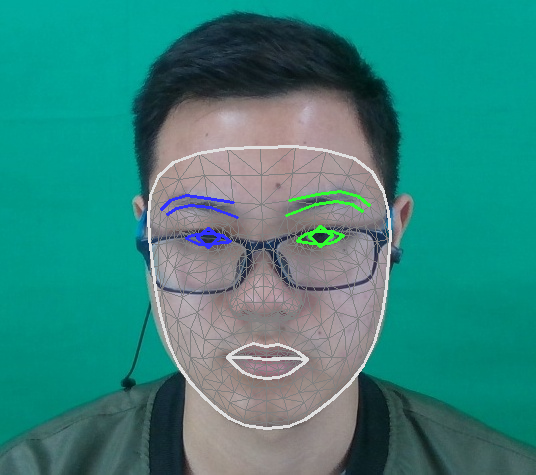

{'img9.jpg': {'browInnerUp': 0.1716793179512024, 'browOuterUpLeft': 0.13236746191978455, 'eyeLookDownLeft': 0.14801891148090363, 'eyeLookDownRight': 0.14949549734592438, 'eyeSquintLeft': 0.4661008417606354, 'eyeSquintRight': 0.36919909715652466, 'mouthPressRight': 0.12983199954032898}, 'img744.jpg': {'browInnerUp': 0.1004304587841034, 'browOuterUpLeft': 0.20178279280662537, 'browOuterUpRight': 0.1044047549366951, 'eyeBlinkLeft': 0.2302534580230713, 'eyeBlinkRight': 0.32938116788864136, 'eyeLookDownRight': 0.10570868849754333, 'eyeLookInRight': 0.19828230142593384, 'eyeLookOutLeft': 0.20405025780200958, 'eyeLookUpLeft': 0.1273510456085205, 'eyeLookUpRight': 0.1056172177195549, 'eyeSquintLeft': 0.6309655904769897, 'eyeSquintRight': 0.40485402941703796, 'mouthPucker': 0.38343706727027893}, 'img2222.jpg': {'browOuterUpLeft': 0.2936858534812927, 'browOuterUpRight': 0.18468357622623444, 'eyeBlinkLeft': 0.6929765343666077, 'eyeBlinkRight': 0.5651941299438477, 'eyeLookDownLeft': 0.712114930152

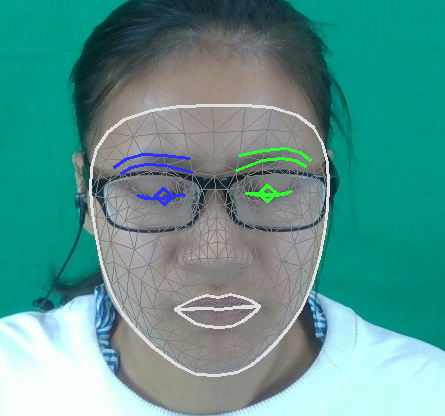

{'img9.jpg': {'browInnerUp': 0.1716793179512024, 'browOuterUpLeft': 0.13236746191978455, 'eyeLookDownLeft': 0.14801891148090363, 'eyeLookDownRight': 0.14949549734592438, 'eyeSquintLeft': 0.4661008417606354, 'eyeSquintRight': 0.36919909715652466, 'mouthPressRight': 0.12983199954032898}, 'img744.jpg': {'browInnerUp': 0.1004304587841034, 'browOuterUpLeft': 0.20178279280662537, 'browOuterUpRight': 0.1044047549366951, 'eyeBlinkLeft': 0.2302534580230713, 'eyeBlinkRight': 0.32938116788864136, 'eyeLookDownRight': 0.10570868849754333, 'eyeLookInRight': 0.19828230142593384, 'eyeLookOutLeft': 0.20405025780200958, 'eyeLookUpLeft': 0.1273510456085205, 'eyeLookUpRight': 0.1056172177195549, 'eyeSquintLeft': 0.6309655904769897, 'eyeSquintRight': 0.40485402941703796, 'mouthPucker': 0.38343706727027893}, 'img2222.jpg': {'browOuterUpLeft': 0.2936858534812927, 'browOuterUpRight': 0.18468357622623444, 'eyeBlinkLeft': 0.6929765343666077, 'eyeBlinkRight': 0.5651941299438477, 'eyeLookDownLeft': 0.712114930152

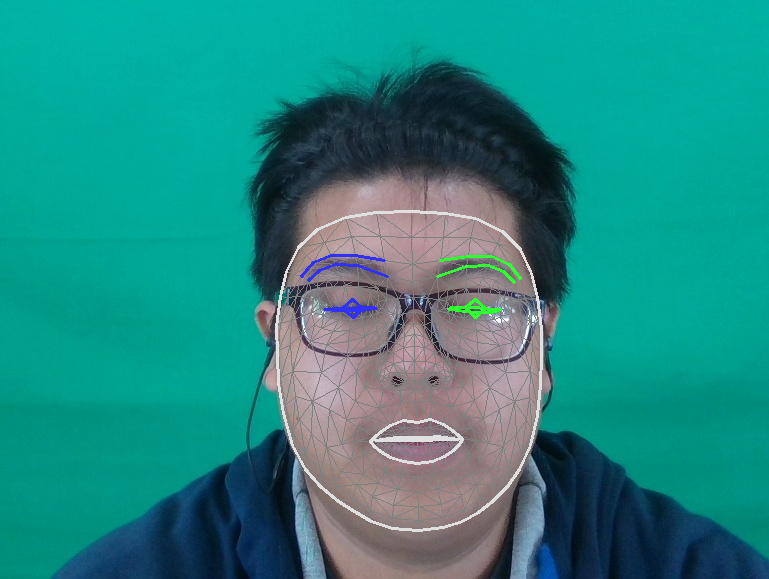

{'img9.jpg': {'browInnerUp': 0.1716793179512024, 'browOuterUpLeft': 0.13236746191978455, 'eyeLookDownLeft': 0.14801891148090363, 'eyeLookDownRight': 0.14949549734592438, 'eyeSquintLeft': 0.4661008417606354, 'eyeSquintRight': 0.36919909715652466, 'mouthPressRight': 0.12983199954032898}, 'img744.jpg': {'browInnerUp': 0.1004304587841034, 'browOuterUpLeft': 0.20178279280662537, 'browOuterUpRight': 0.1044047549366951, 'eyeBlinkLeft': 0.2302534580230713, 'eyeBlinkRight': 0.32938116788864136, 'eyeLookDownRight': 0.10570868849754333, 'eyeLookInRight': 0.19828230142593384, 'eyeLookOutLeft': 0.20405025780200958, 'eyeLookUpLeft': 0.1273510456085205, 'eyeLookUpRight': 0.1056172177195549, 'eyeSquintLeft': 0.6309655904769897, 'eyeSquintRight': 0.40485402941703796, 'mouthPucker': 0.38343706727027893}, 'img2222.jpg': {'browOuterUpLeft': 0.2936858534812927, 'browOuterUpRight': 0.18468357622623444, 'eyeBlinkLeft': 0.6929765343666077, 'eyeBlinkRight': 0.5651941299438477, 'eyeLookDownLeft': 0.712114930152

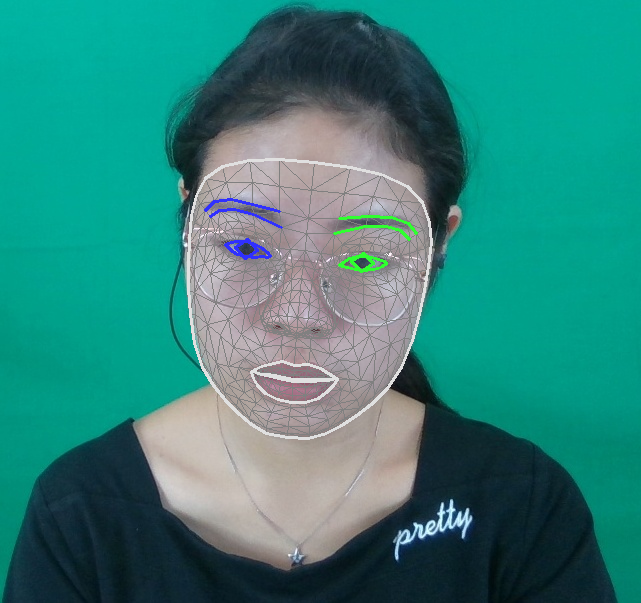

{'img9.jpg': {'browInnerUp': 0.1716793179512024, 'browOuterUpLeft': 0.13236746191978455, 'eyeLookDownLeft': 0.14801891148090363, 'eyeLookDownRight': 0.14949549734592438, 'eyeSquintLeft': 0.4661008417606354, 'eyeSquintRight': 0.36919909715652466, 'mouthPressRight': 0.12983199954032898}, 'img744.jpg': {'browInnerUp': 0.1004304587841034, 'browOuterUpLeft': 0.20178279280662537, 'browOuterUpRight': 0.1044047549366951, 'eyeBlinkLeft': 0.2302534580230713, 'eyeBlinkRight': 0.32938116788864136, 'eyeLookDownRight': 0.10570868849754333, 'eyeLookInRight': 0.19828230142593384, 'eyeLookOutLeft': 0.20405025780200958, 'eyeLookUpLeft': 0.1273510456085205, 'eyeLookUpRight': 0.1056172177195549, 'eyeSquintLeft': 0.6309655904769897, 'eyeSquintRight': 0.40485402941703796, 'mouthPucker': 0.38343706727027893}, 'img2222.jpg': {'browOuterUpLeft': 0.2936858534812927, 'browOuterUpRight': 0.18468357622623444, 'eyeBlinkLeft': 0.6929765343666077, 'eyeBlinkRight': 0.5651941299438477, 'eyeLookDownLeft': 0.712114930152

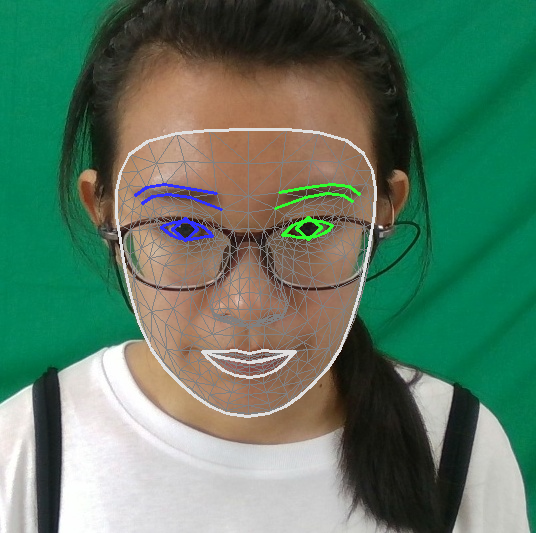

{'img9.jpg': {'browInnerUp': 0.1716793179512024, 'browOuterUpLeft': 0.13236746191978455, 'eyeLookDownLeft': 0.14801891148090363, 'eyeLookDownRight': 0.14949549734592438, 'eyeSquintLeft': 0.4661008417606354, 'eyeSquintRight': 0.36919909715652466, 'mouthPressRight': 0.12983199954032898}, 'img744.jpg': {'browInnerUp': 0.1004304587841034, 'browOuterUpLeft': 0.20178279280662537, 'browOuterUpRight': 0.1044047549366951, 'eyeBlinkLeft': 0.2302534580230713, 'eyeBlinkRight': 0.32938116788864136, 'eyeLookDownRight': 0.10570868849754333, 'eyeLookInRight': 0.19828230142593384, 'eyeLookOutLeft': 0.20405025780200958, 'eyeLookUpLeft': 0.1273510456085205, 'eyeLookUpRight': 0.1056172177195549, 'eyeSquintLeft': 0.6309655904769897, 'eyeSquintRight': 0.40485402941703796, 'mouthPucker': 0.38343706727027893}, 'img2222.jpg': {'browOuterUpLeft': 0.2936858534812927, 'browOuterUpRight': 0.18468357622623444, 'eyeBlinkLeft': 0.6929765343666077, 'eyeBlinkRight': 0.5651941299438477, 'eyeLookDownLeft': 0.712114930152

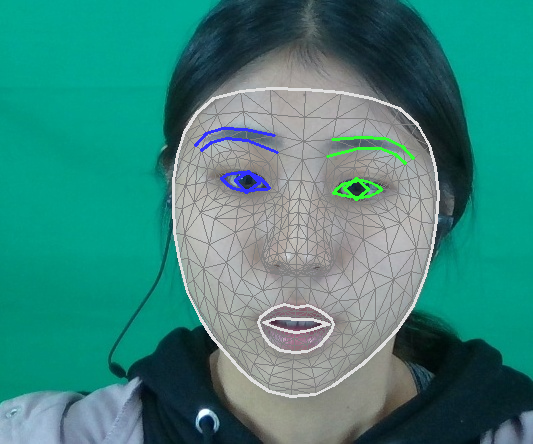

{'img9.jpg': {'browInnerUp': 0.1716793179512024, 'browOuterUpLeft': 0.13236746191978455, 'eyeLookDownLeft': 0.14801891148090363, 'eyeLookDownRight': 0.14949549734592438, 'eyeSquintLeft': 0.4661008417606354, 'eyeSquintRight': 0.36919909715652466, 'mouthPressRight': 0.12983199954032898}, 'img744.jpg': {'browInnerUp': 0.1004304587841034, 'browOuterUpLeft': 0.20178279280662537, 'browOuterUpRight': 0.1044047549366951, 'eyeBlinkLeft': 0.2302534580230713, 'eyeBlinkRight': 0.32938116788864136, 'eyeLookDownRight': 0.10570868849754333, 'eyeLookInRight': 0.19828230142593384, 'eyeLookOutLeft': 0.20405025780200958, 'eyeLookUpLeft': 0.1273510456085205, 'eyeLookUpRight': 0.1056172177195549, 'eyeSquintLeft': 0.6309655904769897, 'eyeSquintRight': 0.40485402941703796, 'mouthPucker': 0.38343706727027893}, 'img2222.jpg': {'browOuterUpLeft': 0.2936858534812927, 'browOuterUpRight': 0.18468357622623444, 'eyeBlinkLeft': 0.6929765343666077, 'eyeBlinkRight': 0.5651941299438477, 'eyeLookDownLeft': 0.712114930152

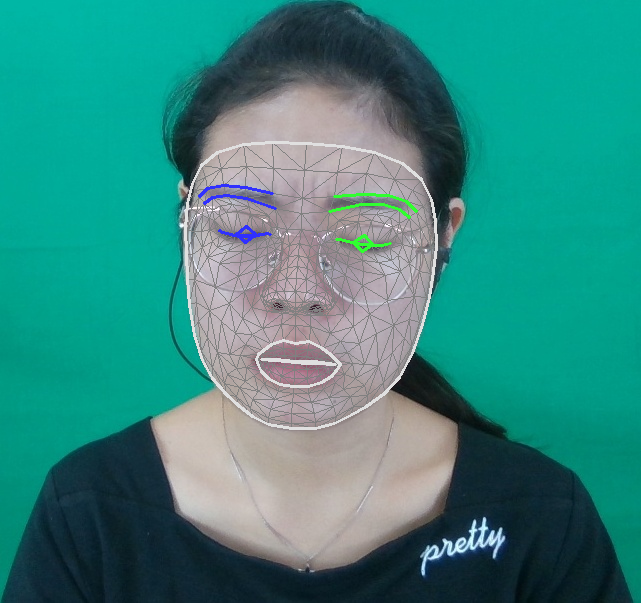

{'img9.jpg': {'browInnerUp': 0.1716793179512024, 'browOuterUpLeft': 0.13236746191978455, 'eyeLookDownLeft': 0.14801891148090363, 'eyeLookDownRight': 0.14949549734592438, 'eyeSquintLeft': 0.4661008417606354, 'eyeSquintRight': 0.36919909715652466, 'mouthPressRight': 0.12983199954032898}, 'img744.jpg': {'browInnerUp': 0.1004304587841034, 'browOuterUpLeft': 0.20178279280662537, 'browOuterUpRight': 0.1044047549366951, 'eyeBlinkLeft': 0.2302534580230713, 'eyeBlinkRight': 0.32938116788864136, 'eyeLookDownRight': 0.10570868849754333, 'eyeLookInRight': 0.19828230142593384, 'eyeLookOutLeft': 0.20405025780200958, 'eyeLookUpLeft': 0.1273510456085205, 'eyeLookUpRight': 0.1056172177195549, 'eyeSquintLeft': 0.6309655904769897, 'eyeSquintRight': 0.40485402941703796, 'mouthPucker': 0.38343706727027893}, 'img2222.jpg': {'browOuterUpLeft': 0.2936858534812927, 'browOuterUpRight': 0.18468357622623444, 'eyeBlinkLeft': 0.6929765343666077, 'eyeBlinkRight': 0.5651941299438477, 'eyeLookDownLeft': 0.712114930152

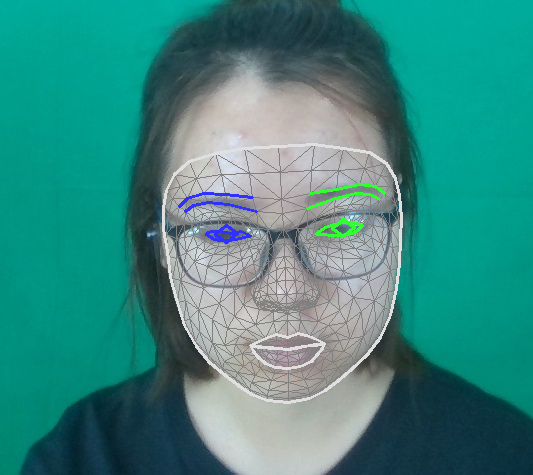

{'img9.jpg': {'browInnerUp': 0.1716793179512024, 'browOuterUpLeft': 0.13236746191978455, 'eyeLookDownLeft': 0.14801891148090363, 'eyeLookDownRight': 0.14949549734592438, 'eyeSquintLeft': 0.4661008417606354, 'eyeSquintRight': 0.36919909715652466, 'mouthPressRight': 0.12983199954032898}, 'img744.jpg': {'browInnerUp': 0.1004304587841034, 'browOuterUpLeft': 0.20178279280662537, 'browOuterUpRight': 0.1044047549366951, 'eyeBlinkLeft': 0.2302534580230713, 'eyeBlinkRight': 0.32938116788864136, 'eyeLookDownRight': 0.10570868849754333, 'eyeLookInRight': 0.19828230142593384, 'eyeLookOutLeft': 0.20405025780200958, 'eyeLookUpLeft': 0.1273510456085205, 'eyeLookUpRight': 0.1056172177195549, 'eyeSquintLeft': 0.6309655904769897, 'eyeSquintRight': 0.40485402941703796, 'mouthPucker': 0.38343706727027893}, 'img2222.jpg': {'browOuterUpLeft': 0.2936858534812927, 'browOuterUpRight': 0.18468357622623444, 'eyeBlinkLeft': 0.6929765343666077, 'eyeBlinkRight': 0.5651941299438477, 'eyeLookDownLeft': 0.712114930152

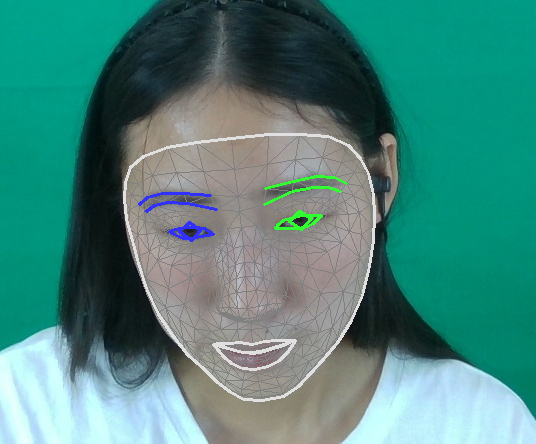

{'img9.jpg': {'browInnerUp': 0.1716793179512024, 'browOuterUpLeft': 0.13236746191978455, 'eyeLookDownLeft': 0.14801891148090363, 'eyeLookDownRight': 0.14949549734592438, 'eyeSquintLeft': 0.4661008417606354, 'eyeSquintRight': 0.36919909715652466, 'mouthPressRight': 0.12983199954032898}, 'img744.jpg': {'browInnerUp': 0.1004304587841034, 'browOuterUpLeft': 0.20178279280662537, 'browOuterUpRight': 0.1044047549366951, 'eyeBlinkLeft': 0.2302534580230713, 'eyeBlinkRight': 0.32938116788864136, 'eyeLookDownRight': 0.10570868849754333, 'eyeLookInRight': 0.19828230142593384, 'eyeLookOutLeft': 0.20405025780200958, 'eyeLookUpLeft': 0.1273510456085205, 'eyeLookUpRight': 0.1056172177195549, 'eyeSquintLeft': 0.6309655904769897, 'eyeSquintRight': 0.40485402941703796, 'mouthPucker': 0.38343706727027893}, 'img2222.jpg': {'browOuterUpLeft': 0.2936858534812927, 'browOuterUpRight': 0.18468357622623444, 'eyeBlinkLeft': 0.6929765343666077, 'eyeBlinkRight': 0.5651941299438477, 'eyeLookDownLeft': 0.712114930152

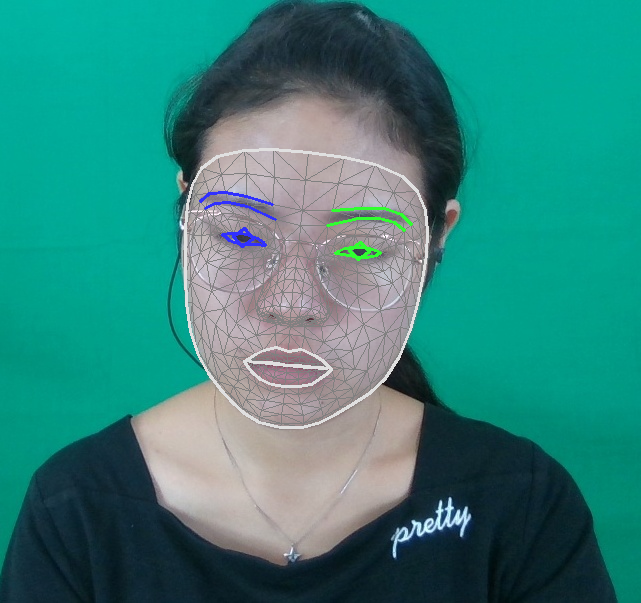

{'img9.jpg': {'browInnerUp': 0.1716793179512024, 'browOuterUpLeft': 0.13236746191978455, 'eyeLookDownLeft': 0.14801891148090363, 'eyeLookDownRight': 0.14949549734592438, 'eyeSquintLeft': 0.4661008417606354, 'eyeSquintRight': 0.36919909715652466, 'mouthPressRight': 0.12983199954032898}, 'img744.jpg': {'browInnerUp': 0.1004304587841034, 'browOuterUpLeft': 0.20178279280662537, 'browOuterUpRight': 0.1044047549366951, 'eyeBlinkLeft': 0.2302534580230713, 'eyeBlinkRight': 0.32938116788864136, 'eyeLookDownRight': 0.10570868849754333, 'eyeLookInRight': 0.19828230142593384, 'eyeLookOutLeft': 0.20405025780200958, 'eyeLookUpLeft': 0.1273510456085205, 'eyeLookUpRight': 0.1056172177195549, 'eyeSquintLeft': 0.6309655904769897, 'eyeSquintRight': 0.40485402941703796, 'mouthPucker': 0.38343706727027893}, 'img2222.jpg': {'browOuterUpLeft': 0.2936858534812927, 'browOuterUpRight': 0.18468357622623444, 'eyeBlinkLeft': 0.6929765343666077, 'eyeBlinkRight': 0.5651941299438477, 'eyeLookDownLeft': 0.712114930152

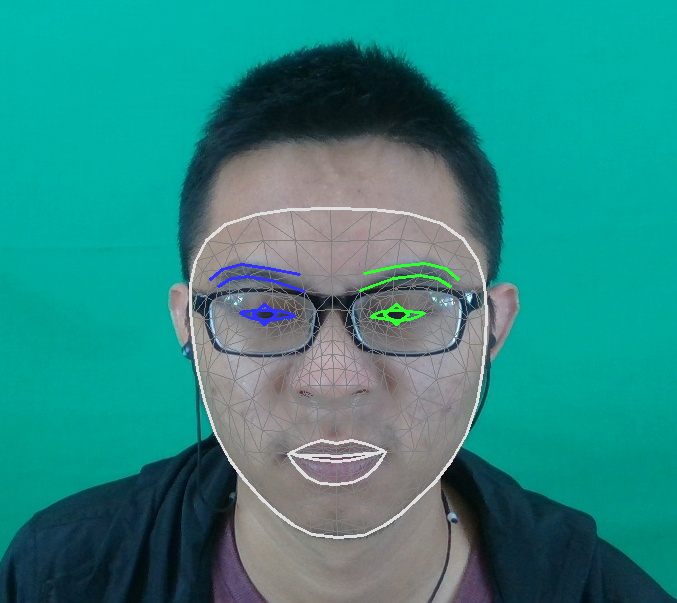

{'img9.jpg': {'browInnerUp': 0.1716793179512024, 'browOuterUpLeft': 0.13236746191978455, 'eyeLookDownLeft': 0.14801891148090363, 'eyeLookDownRight': 0.14949549734592438, 'eyeSquintLeft': 0.4661008417606354, 'eyeSquintRight': 0.36919909715652466, 'mouthPressRight': 0.12983199954032898}, 'img744.jpg': {'browInnerUp': 0.1004304587841034, 'browOuterUpLeft': 0.20178279280662537, 'browOuterUpRight': 0.1044047549366951, 'eyeBlinkLeft': 0.2302534580230713, 'eyeBlinkRight': 0.32938116788864136, 'eyeLookDownRight': 0.10570868849754333, 'eyeLookInRight': 0.19828230142593384, 'eyeLookOutLeft': 0.20405025780200958, 'eyeLookUpLeft': 0.1273510456085205, 'eyeLookUpRight': 0.1056172177195549, 'eyeSquintLeft': 0.6309655904769897, 'eyeSquintRight': 0.40485402941703796, 'mouthPucker': 0.38343706727027893}, 'img2222.jpg': {'browOuterUpLeft': 0.2936858534812927, 'browOuterUpRight': 0.18468357622623444, 'eyeBlinkLeft': 0.6929765343666077, 'eyeBlinkRight': 0.5651941299438477, 'eyeLookDownLeft': 0.712114930152

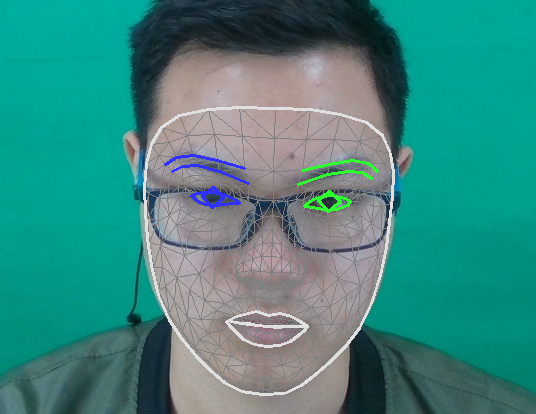

{'img9.jpg': {'browInnerUp': 0.1716793179512024, 'browOuterUpLeft': 0.13236746191978455, 'eyeLookDownLeft': 0.14801891148090363, 'eyeLookDownRight': 0.14949549734592438, 'eyeSquintLeft': 0.4661008417606354, 'eyeSquintRight': 0.36919909715652466, 'mouthPressRight': 0.12983199954032898}, 'img744.jpg': {'browInnerUp': 0.1004304587841034, 'browOuterUpLeft': 0.20178279280662537, 'browOuterUpRight': 0.1044047549366951, 'eyeBlinkLeft': 0.2302534580230713, 'eyeBlinkRight': 0.32938116788864136, 'eyeLookDownRight': 0.10570868849754333, 'eyeLookInRight': 0.19828230142593384, 'eyeLookOutLeft': 0.20405025780200958, 'eyeLookUpLeft': 0.1273510456085205, 'eyeLookUpRight': 0.1056172177195549, 'eyeSquintLeft': 0.6309655904769897, 'eyeSquintRight': 0.40485402941703796, 'mouthPucker': 0.38343706727027893}, 'img2222.jpg': {'browOuterUpLeft': 0.2936858534812927, 'browOuterUpRight': 0.18468357622623444, 'eyeBlinkLeft': 0.6929765343666077, 'eyeBlinkRight': 0.5651941299438477, 'eyeLookDownLeft': 0.712114930152

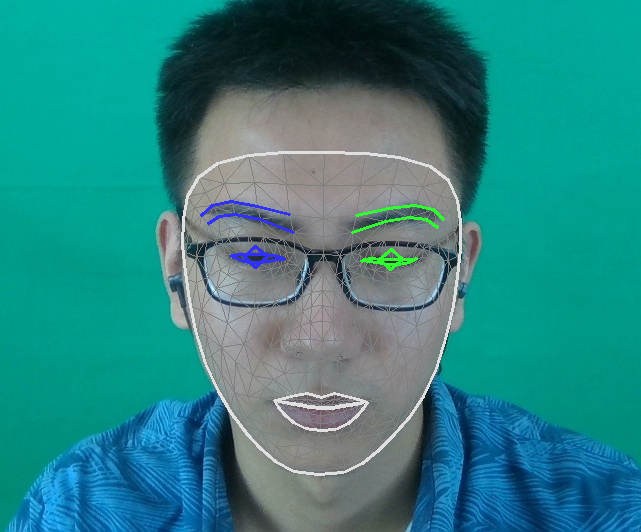

{'img9.jpg': {'browInnerUp': 0.1716793179512024, 'browOuterUpLeft': 0.13236746191978455, 'eyeLookDownLeft': 0.14801891148090363, 'eyeLookDownRight': 0.14949549734592438, 'eyeSquintLeft': 0.4661008417606354, 'eyeSquintRight': 0.36919909715652466, 'mouthPressRight': 0.12983199954032898}, 'img744.jpg': {'browInnerUp': 0.1004304587841034, 'browOuterUpLeft': 0.20178279280662537, 'browOuterUpRight': 0.1044047549366951, 'eyeBlinkLeft': 0.2302534580230713, 'eyeBlinkRight': 0.32938116788864136, 'eyeLookDownRight': 0.10570868849754333, 'eyeLookInRight': 0.19828230142593384, 'eyeLookOutLeft': 0.20405025780200958, 'eyeLookUpLeft': 0.1273510456085205, 'eyeLookUpRight': 0.1056172177195549, 'eyeSquintLeft': 0.6309655904769897, 'eyeSquintRight': 0.40485402941703796, 'mouthPucker': 0.38343706727027893}, 'img2222.jpg': {'browOuterUpLeft': 0.2936858534812927, 'browOuterUpRight': 0.18468357622623444, 'eyeBlinkLeft': 0.6929765343666077, 'eyeBlinkRight': 0.5651941299438477, 'eyeLookDownLeft': 0.712114930152

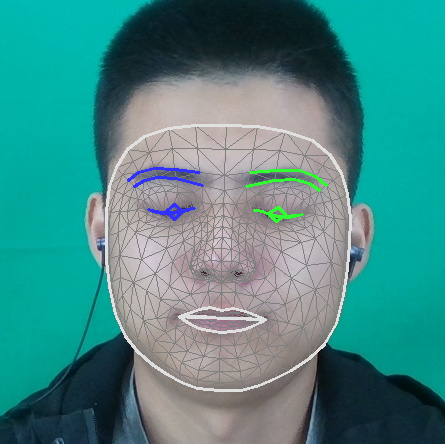

{'img9.jpg': {'browInnerUp': 0.1716793179512024, 'browOuterUpLeft': 0.13236746191978455, 'eyeLookDownLeft': 0.14801891148090363, 'eyeLookDownRight': 0.14949549734592438, 'eyeSquintLeft': 0.4661008417606354, 'eyeSquintRight': 0.36919909715652466, 'mouthPressRight': 0.12983199954032898}, 'img744.jpg': {'browInnerUp': 0.1004304587841034, 'browOuterUpLeft': 0.20178279280662537, 'browOuterUpRight': 0.1044047549366951, 'eyeBlinkLeft': 0.2302534580230713, 'eyeBlinkRight': 0.32938116788864136, 'eyeLookDownRight': 0.10570868849754333, 'eyeLookInRight': 0.19828230142593384, 'eyeLookOutLeft': 0.20405025780200958, 'eyeLookUpLeft': 0.1273510456085205, 'eyeLookUpRight': 0.1056172177195549, 'eyeSquintLeft': 0.6309655904769897, 'eyeSquintRight': 0.40485402941703796, 'mouthPucker': 0.38343706727027893}, 'img2222.jpg': {'browOuterUpLeft': 0.2936858534812927, 'browOuterUpRight': 0.18468357622623444, 'eyeBlinkLeft': 0.6929765343666077, 'eyeBlinkRight': 0.5651941299438477, 'eyeLookDownLeft': 0.712114930152

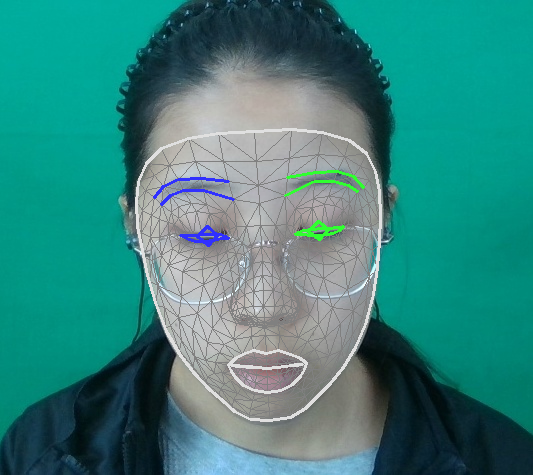

{'img9.jpg': {'browInnerUp': 0.1716793179512024, 'browOuterUpLeft': 0.13236746191978455, 'eyeLookDownLeft': 0.14801891148090363, 'eyeLookDownRight': 0.14949549734592438, 'eyeSquintLeft': 0.4661008417606354, 'eyeSquintRight': 0.36919909715652466, 'mouthPressRight': 0.12983199954032898}, 'img744.jpg': {'browInnerUp': 0.1004304587841034, 'browOuterUpLeft': 0.20178279280662537, 'browOuterUpRight': 0.1044047549366951, 'eyeBlinkLeft': 0.2302534580230713, 'eyeBlinkRight': 0.32938116788864136, 'eyeLookDownRight': 0.10570868849754333, 'eyeLookInRight': 0.19828230142593384, 'eyeLookOutLeft': 0.20405025780200958, 'eyeLookUpLeft': 0.1273510456085205, 'eyeLookUpRight': 0.1056172177195549, 'eyeSquintLeft': 0.6309655904769897, 'eyeSquintRight': 0.40485402941703796, 'mouthPucker': 0.38343706727027893}, 'img2222.jpg': {'browOuterUpLeft': 0.2936858534812927, 'browOuterUpRight': 0.18468357622623444, 'eyeBlinkLeft': 0.6929765343666077, 'eyeBlinkRight': 0.5651941299438477, 'eyeLookDownLeft': 0.712114930152

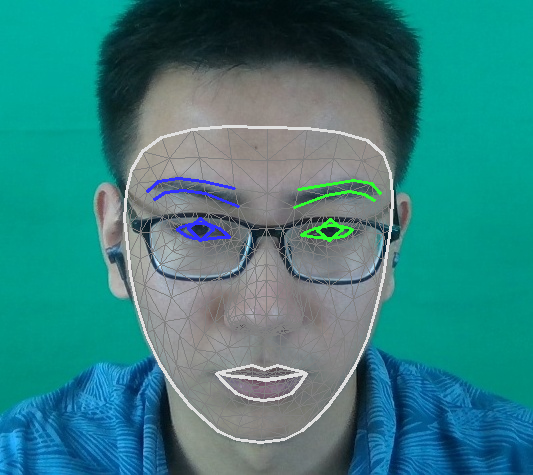

{'img9.jpg': {'browInnerUp': 0.1716793179512024, 'browOuterUpLeft': 0.13236746191978455, 'eyeLookDownLeft': 0.14801891148090363, 'eyeLookDownRight': 0.14949549734592438, 'eyeSquintLeft': 0.4661008417606354, 'eyeSquintRight': 0.36919909715652466, 'mouthPressRight': 0.12983199954032898}, 'img744.jpg': {'browInnerUp': 0.1004304587841034, 'browOuterUpLeft': 0.20178279280662537, 'browOuterUpRight': 0.1044047549366951, 'eyeBlinkLeft': 0.2302534580230713, 'eyeBlinkRight': 0.32938116788864136, 'eyeLookDownRight': 0.10570868849754333, 'eyeLookInRight': 0.19828230142593384, 'eyeLookOutLeft': 0.20405025780200958, 'eyeLookUpLeft': 0.1273510456085205, 'eyeLookUpRight': 0.1056172177195549, 'eyeSquintLeft': 0.6309655904769897, 'eyeSquintRight': 0.40485402941703796, 'mouthPucker': 0.38343706727027893}, 'img2222.jpg': {'browOuterUpLeft': 0.2936858534812927, 'browOuterUpRight': 0.18468357622623444, 'eyeBlinkLeft': 0.6929765343666077, 'eyeBlinkRight': 0.5651941299438477, 'eyeLookDownLeft': 0.712114930152

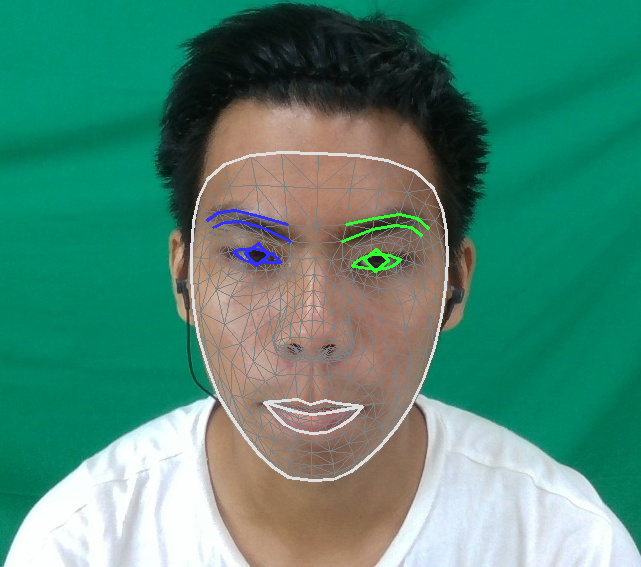

{'img9.jpg': {'browInnerUp': 0.1716793179512024, 'browOuterUpLeft': 0.13236746191978455, 'eyeLookDownLeft': 0.14801891148090363, 'eyeLookDownRight': 0.14949549734592438, 'eyeSquintLeft': 0.4661008417606354, 'eyeSquintRight': 0.36919909715652466, 'mouthPressRight': 0.12983199954032898}, 'img744.jpg': {'browInnerUp': 0.1004304587841034, 'browOuterUpLeft': 0.20178279280662537, 'browOuterUpRight': 0.1044047549366951, 'eyeBlinkLeft': 0.2302534580230713, 'eyeBlinkRight': 0.32938116788864136, 'eyeLookDownRight': 0.10570868849754333, 'eyeLookInRight': 0.19828230142593384, 'eyeLookOutLeft': 0.20405025780200958, 'eyeLookUpLeft': 0.1273510456085205, 'eyeLookUpRight': 0.1056172177195549, 'eyeSquintLeft': 0.6309655904769897, 'eyeSquintRight': 0.40485402941703796, 'mouthPucker': 0.38343706727027893}, 'img2222.jpg': {'browOuterUpLeft': 0.2936858534812927, 'browOuterUpRight': 0.18468357622623444, 'eyeBlinkLeft': 0.6929765343666077, 'eyeBlinkRight': 0.5651941299438477, 'eyeLookDownLeft': 0.712114930152

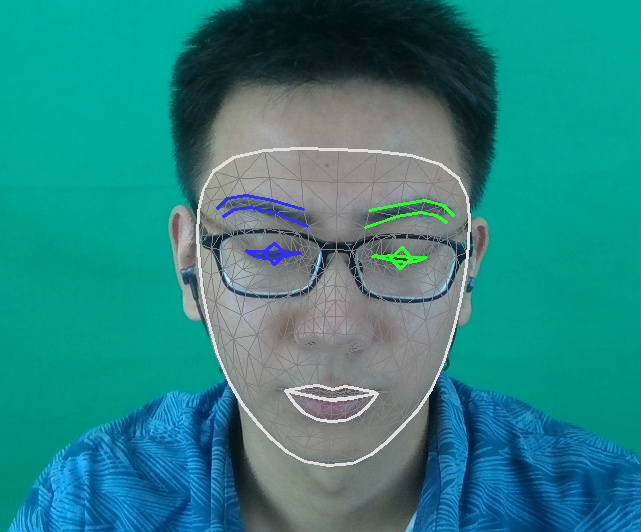

{'img9.jpg': {'browInnerUp': 0.1716793179512024, 'browOuterUpLeft': 0.13236746191978455, 'eyeLookDownLeft': 0.14801891148090363, 'eyeLookDownRight': 0.14949549734592438, 'eyeSquintLeft': 0.4661008417606354, 'eyeSquintRight': 0.36919909715652466, 'mouthPressRight': 0.12983199954032898}, 'img744.jpg': {'browInnerUp': 0.1004304587841034, 'browOuterUpLeft': 0.20178279280662537, 'browOuterUpRight': 0.1044047549366951, 'eyeBlinkLeft': 0.2302534580230713, 'eyeBlinkRight': 0.32938116788864136, 'eyeLookDownRight': 0.10570868849754333, 'eyeLookInRight': 0.19828230142593384, 'eyeLookOutLeft': 0.20405025780200958, 'eyeLookUpLeft': 0.1273510456085205, 'eyeLookUpRight': 0.1056172177195549, 'eyeSquintLeft': 0.6309655904769897, 'eyeSquintRight': 0.40485402941703796, 'mouthPucker': 0.38343706727027893}, 'img2222.jpg': {'browOuterUpLeft': 0.2936858534812927, 'browOuterUpRight': 0.18468357622623444, 'eyeBlinkLeft': 0.6929765343666077, 'eyeBlinkRight': 0.5651941299438477, 'eyeLookDownLeft': 0.712114930152

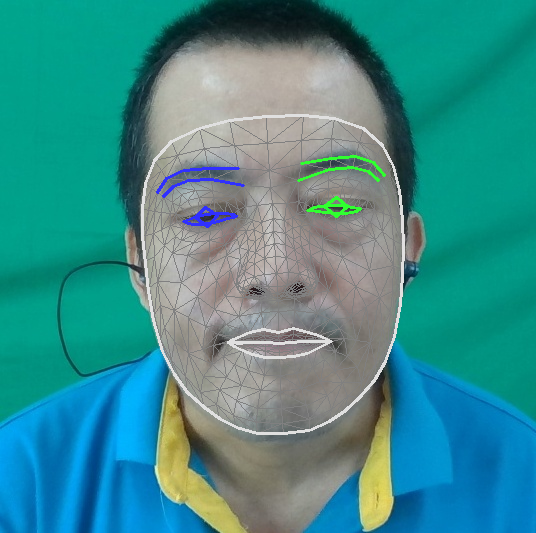

{'img9.jpg': {'browInnerUp': 0.1716793179512024, 'browOuterUpLeft': 0.13236746191978455, 'eyeLookDownLeft': 0.14801891148090363, 'eyeLookDownRight': 0.14949549734592438, 'eyeSquintLeft': 0.4661008417606354, 'eyeSquintRight': 0.36919909715652466, 'mouthPressRight': 0.12983199954032898}, 'img744.jpg': {'browInnerUp': 0.1004304587841034, 'browOuterUpLeft': 0.20178279280662537, 'browOuterUpRight': 0.1044047549366951, 'eyeBlinkLeft': 0.2302534580230713, 'eyeBlinkRight': 0.32938116788864136, 'eyeLookDownRight': 0.10570868849754333, 'eyeLookInRight': 0.19828230142593384, 'eyeLookOutLeft': 0.20405025780200958, 'eyeLookUpLeft': 0.1273510456085205, 'eyeLookUpRight': 0.1056172177195549, 'eyeSquintLeft': 0.6309655904769897, 'eyeSquintRight': 0.40485402941703796, 'mouthPucker': 0.38343706727027893}, 'img2222.jpg': {'browOuterUpLeft': 0.2936858534812927, 'browOuterUpRight': 0.18468357622623444, 'eyeBlinkLeft': 0.6929765343666077, 'eyeBlinkRight': 0.5651941299438477, 'eyeLookDownLeft': 0.712114930152

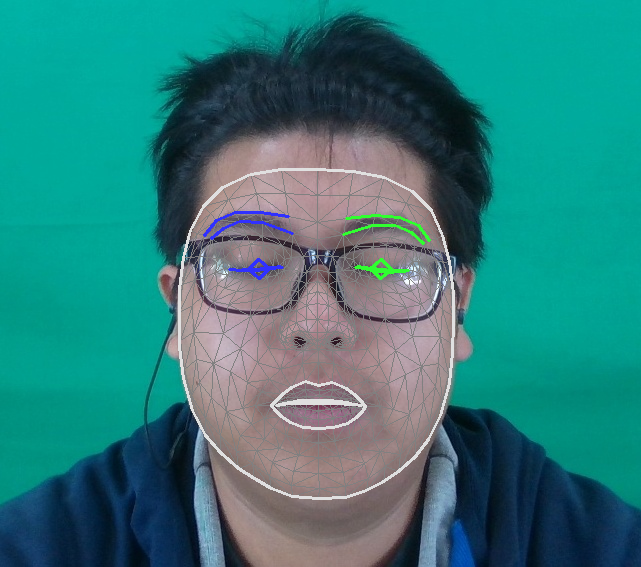

{'img9.jpg': {'browInnerUp': 0.1716793179512024, 'browOuterUpLeft': 0.13236746191978455, 'eyeLookDownLeft': 0.14801891148090363, 'eyeLookDownRight': 0.14949549734592438, 'eyeSquintLeft': 0.4661008417606354, 'eyeSquintRight': 0.36919909715652466, 'mouthPressRight': 0.12983199954032898}, 'img744.jpg': {'browInnerUp': 0.1004304587841034, 'browOuterUpLeft': 0.20178279280662537, 'browOuterUpRight': 0.1044047549366951, 'eyeBlinkLeft': 0.2302534580230713, 'eyeBlinkRight': 0.32938116788864136, 'eyeLookDownRight': 0.10570868849754333, 'eyeLookInRight': 0.19828230142593384, 'eyeLookOutLeft': 0.20405025780200958, 'eyeLookUpLeft': 0.1273510456085205, 'eyeLookUpRight': 0.1056172177195549, 'eyeSquintLeft': 0.6309655904769897, 'eyeSquintRight': 0.40485402941703796, 'mouthPucker': 0.38343706727027893}, 'img2222.jpg': {'browOuterUpLeft': 0.2936858534812927, 'browOuterUpRight': 0.18468357622623444, 'eyeBlinkLeft': 0.6929765343666077, 'eyeBlinkRight': 0.5651941299438477, 'eyeLookDownLeft': 0.712114930152

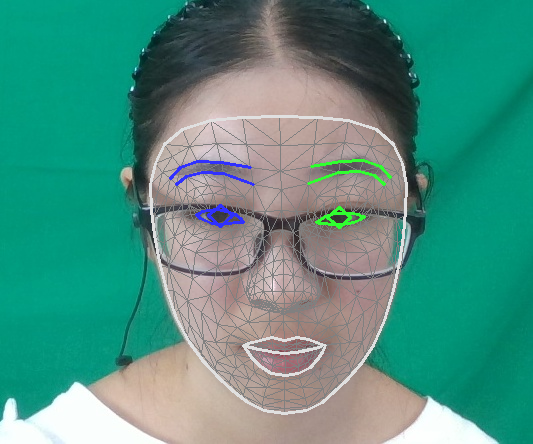

{'img9.jpg': {'browInnerUp': 0.1716793179512024, 'browOuterUpLeft': 0.13236746191978455, 'eyeLookDownLeft': 0.14801891148090363, 'eyeLookDownRight': 0.14949549734592438, 'eyeSquintLeft': 0.4661008417606354, 'eyeSquintRight': 0.36919909715652466, 'mouthPressRight': 0.12983199954032898}, 'img744.jpg': {'browInnerUp': 0.1004304587841034, 'browOuterUpLeft': 0.20178279280662537, 'browOuterUpRight': 0.1044047549366951, 'eyeBlinkLeft': 0.2302534580230713, 'eyeBlinkRight': 0.32938116788864136, 'eyeLookDownRight': 0.10570868849754333, 'eyeLookInRight': 0.19828230142593384, 'eyeLookOutLeft': 0.20405025780200958, 'eyeLookUpLeft': 0.1273510456085205, 'eyeLookUpRight': 0.1056172177195549, 'eyeSquintLeft': 0.6309655904769897, 'eyeSquintRight': 0.40485402941703796, 'mouthPucker': 0.38343706727027893}, 'img2222.jpg': {'browOuterUpLeft': 0.2936858534812927, 'browOuterUpRight': 0.18468357622623444, 'eyeBlinkLeft': 0.6929765343666077, 'eyeBlinkRight': 0.5651941299438477, 'eyeLookDownLeft': 0.712114930152

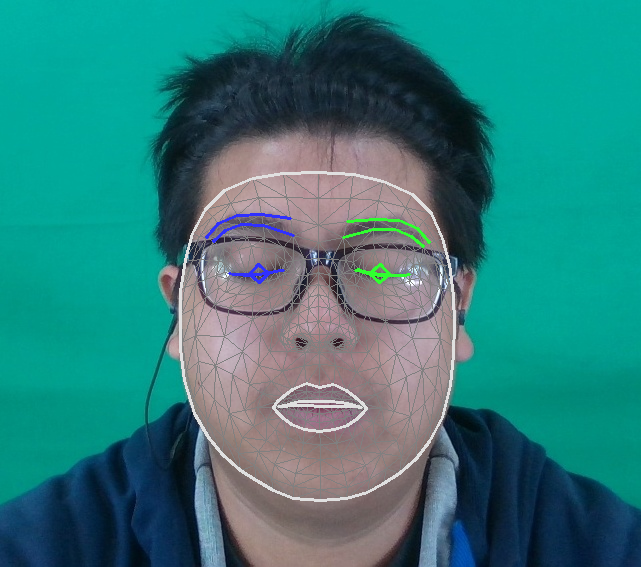

{'img9.jpg': {'browInnerUp': 0.1716793179512024, 'browOuterUpLeft': 0.13236746191978455, 'eyeLookDownLeft': 0.14801891148090363, 'eyeLookDownRight': 0.14949549734592438, 'eyeSquintLeft': 0.4661008417606354, 'eyeSquintRight': 0.36919909715652466, 'mouthPressRight': 0.12983199954032898}, 'img744.jpg': {'browInnerUp': 0.1004304587841034, 'browOuterUpLeft': 0.20178279280662537, 'browOuterUpRight': 0.1044047549366951, 'eyeBlinkLeft': 0.2302534580230713, 'eyeBlinkRight': 0.32938116788864136, 'eyeLookDownRight': 0.10570868849754333, 'eyeLookInRight': 0.19828230142593384, 'eyeLookOutLeft': 0.20405025780200958, 'eyeLookUpLeft': 0.1273510456085205, 'eyeLookUpRight': 0.1056172177195549, 'eyeSquintLeft': 0.6309655904769897, 'eyeSquintRight': 0.40485402941703796, 'mouthPucker': 0.38343706727027893}, 'img2222.jpg': {'browOuterUpLeft': 0.2936858534812927, 'browOuterUpRight': 0.18468357622623444, 'eyeBlinkLeft': 0.6929765343666077, 'eyeBlinkRight': 0.5651941299438477, 'eyeLookDownLeft': 0.712114930152

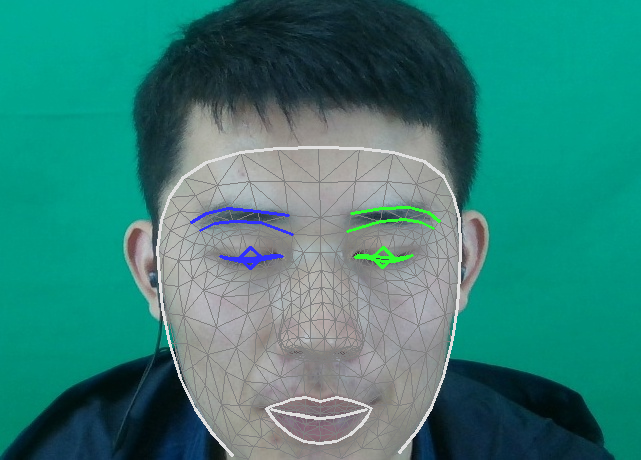

{'img9.jpg': {'browInnerUp': 0.1716793179512024, 'browOuterUpLeft': 0.13236746191978455, 'eyeLookDownLeft': 0.14801891148090363, 'eyeLookDownRight': 0.14949549734592438, 'eyeSquintLeft': 0.4661008417606354, 'eyeSquintRight': 0.36919909715652466, 'mouthPressRight': 0.12983199954032898}, 'img744.jpg': {'browInnerUp': 0.1004304587841034, 'browOuterUpLeft': 0.20178279280662537, 'browOuterUpRight': 0.1044047549366951, 'eyeBlinkLeft': 0.2302534580230713, 'eyeBlinkRight': 0.32938116788864136, 'eyeLookDownRight': 0.10570868849754333, 'eyeLookInRight': 0.19828230142593384, 'eyeLookOutLeft': 0.20405025780200958, 'eyeLookUpLeft': 0.1273510456085205, 'eyeLookUpRight': 0.1056172177195549, 'eyeSquintLeft': 0.6309655904769897, 'eyeSquintRight': 0.40485402941703796, 'mouthPucker': 0.38343706727027893}, 'img2222.jpg': {'browOuterUpLeft': 0.2936858534812927, 'browOuterUpRight': 0.18468357622623444, 'eyeBlinkLeft': 0.6929765343666077, 'eyeBlinkRight': 0.5651941299438477, 'eyeLookDownLeft': 0.712114930152

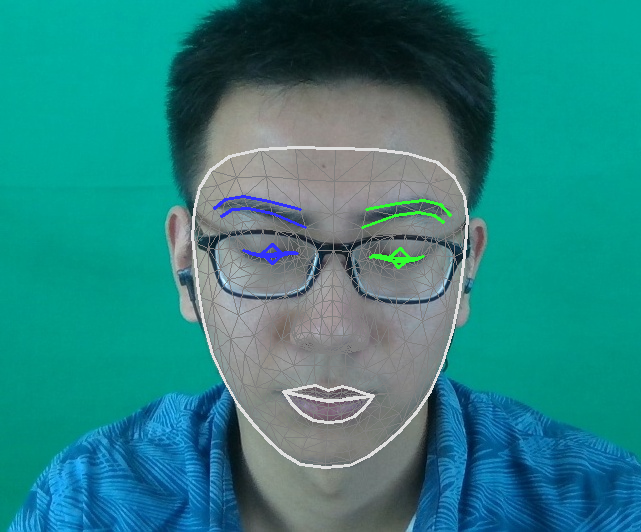

{'img9.jpg': {'browInnerUp': 0.1716793179512024, 'browOuterUpLeft': 0.13236746191978455, 'eyeLookDownLeft': 0.14801891148090363, 'eyeLookDownRight': 0.14949549734592438, 'eyeSquintLeft': 0.4661008417606354, 'eyeSquintRight': 0.36919909715652466, 'mouthPressRight': 0.12983199954032898}, 'img744.jpg': {'browInnerUp': 0.1004304587841034, 'browOuterUpLeft': 0.20178279280662537, 'browOuterUpRight': 0.1044047549366951, 'eyeBlinkLeft': 0.2302534580230713, 'eyeBlinkRight': 0.32938116788864136, 'eyeLookDownRight': 0.10570868849754333, 'eyeLookInRight': 0.19828230142593384, 'eyeLookOutLeft': 0.20405025780200958, 'eyeLookUpLeft': 0.1273510456085205, 'eyeLookUpRight': 0.1056172177195549, 'eyeSquintLeft': 0.6309655904769897, 'eyeSquintRight': 0.40485402941703796, 'mouthPucker': 0.38343706727027893}, 'img2222.jpg': {'browOuterUpLeft': 0.2936858534812927, 'browOuterUpRight': 0.18468357622623444, 'eyeBlinkLeft': 0.6929765343666077, 'eyeBlinkRight': 0.5651941299438477, 'eyeLookDownLeft': 0.712114930152

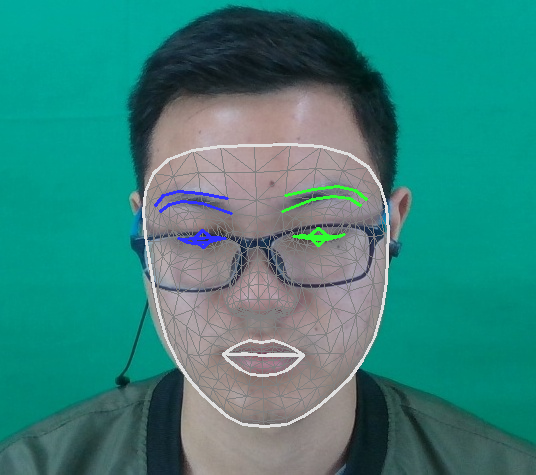

{'img9.jpg': {'browInnerUp': 0.1716793179512024, 'browOuterUpLeft': 0.13236746191978455, 'eyeLookDownLeft': 0.14801891148090363, 'eyeLookDownRight': 0.14949549734592438, 'eyeSquintLeft': 0.4661008417606354, 'eyeSquintRight': 0.36919909715652466, 'mouthPressRight': 0.12983199954032898}, 'img744.jpg': {'browInnerUp': 0.1004304587841034, 'browOuterUpLeft': 0.20178279280662537, 'browOuterUpRight': 0.1044047549366951, 'eyeBlinkLeft': 0.2302534580230713, 'eyeBlinkRight': 0.32938116788864136, 'eyeLookDownRight': 0.10570868849754333, 'eyeLookInRight': 0.19828230142593384, 'eyeLookOutLeft': 0.20405025780200958, 'eyeLookUpLeft': 0.1273510456085205, 'eyeLookUpRight': 0.1056172177195549, 'eyeSquintLeft': 0.6309655904769897, 'eyeSquintRight': 0.40485402941703796, 'mouthPucker': 0.38343706727027893}, 'img2222.jpg': {'browOuterUpLeft': 0.2936858534812927, 'browOuterUpRight': 0.18468357622623444, 'eyeBlinkLeft': 0.6929765343666077, 'eyeBlinkRight': 0.5651941299438477, 'eyeLookDownLeft': 0.712114930152

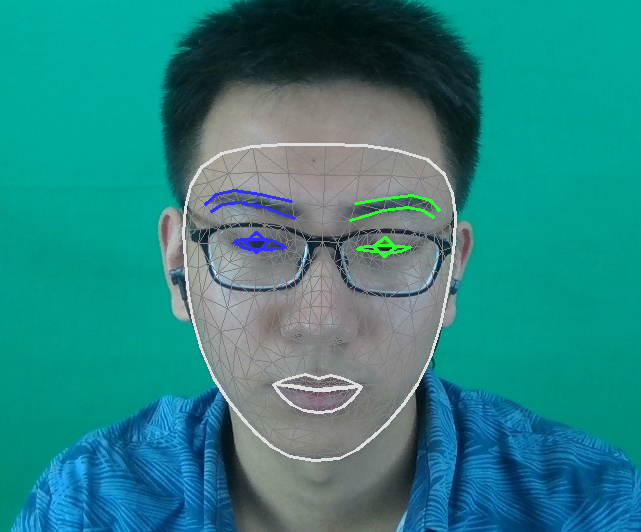

{'img9.jpg': {'browInnerUp': 0.1716793179512024, 'browOuterUpLeft': 0.13236746191978455, 'eyeLookDownLeft': 0.14801891148090363, 'eyeLookDownRight': 0.14949549734592438, 'eyeSquintLeft': 0.4661008417606354, 'eyeSquintRight': 0.36919909715652466, 'mouthPressRight': 0.12983199954032898}, 'img744.jpg': {'browInnerUp': 0.1004304587841034, 'browOuterUpLeft': 0.20178279280662537, 'browOuterUpRight': 0.1044047549366951, 'eyeBlinkLeft': 0.2302534580230713, 'eyeBlinkRight': 0.32938116788864136, 'eyeLookDownRight': 0.10570868849754333, 'eyeLookInRight': 0.19828230142593384, 'eyeLookOutLeft': 0.20405025780200958, 'eyeLookUpLeft': 0.1273510456085205, 'eyeLookUpRight': 0.1056172177195549, 'eyeSquintLeft': 0.6309655904769897, 'eyeSquintRight': 0.40485402941703796, 'mouthPucker': 0.38343706727027893}, 'img2222.jpg': {'browOuterUpLeft': 0.2936858534812927, 'browOuterUpRight': 0.18468357622623444, 'eyeBlinkLeft': 0.6929765343666077, 'eyeBlinkRight': 0.5651941299438477, 'eyeLookDownLeft': 0.712114930152

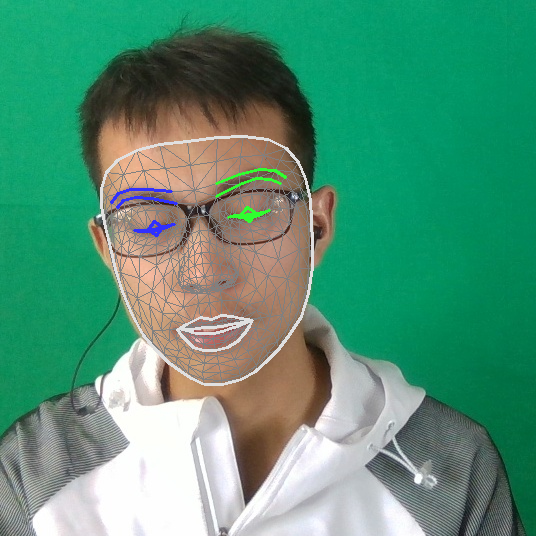

{'img9.jpg': {'browInnerUp': 0.1716793179512024, 'browOuterUpLeft': 0.13236746191978455, 'eyeLookDownLeft': 0.14801891148090363, 'eyeLookDownRight': 0.14949549734592438, 'eyeSquintLeft': 0.4661008417606354, 'eyeSquintRight': 0.36919909715652466, 'mouthPressRight': 0.12983199954032898}, 'img744.jpg': {'browInnerUp': 0.1004304587841034, 'browOuterUpLeft': 0.20178279280662537, 'browOuterUpRight': 0.1044047549366951, 'eyeBlinkLeft': 0.2302534580230713, 'eyeBlinkRight': 0.32938116788864136, 'eyeLookDownRight': 0.10570868849754333, 'eyeLookInRight': 0.19828230142593384, 'eyeLookOutLeft': 0.20405025780200958, 'eyeLookUpLeft': 0.1273510456085205, 'eyeLookUpRight': 0.1056172177195549, 'eyeSquintLeft': 0.6309655904769897, 'eyeSquintRight': 0.40485402941703796, 'mouthPucker': 0.38343706727027893}, 'img2222.jpg': {'browOuterUpLeft': 0.2936858534812927, 'browOuterUpRight': 0.18468357622623444, 'eyeBlinkLeft': 0.6929765343666077, 'eyeBlinkRight': 0.5651941299438477, 'eyeLookDownLeft': 0.712114930152

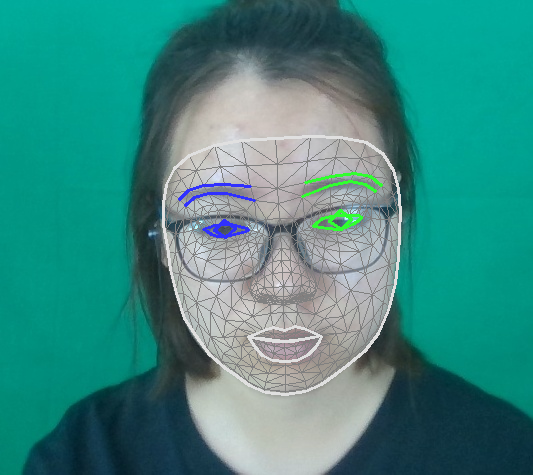

{'img9.jpg': {'browInnerUp': 0.1716793179512024, 'browOuterUpLeft': 0.13236746191978455, 'eyeLookDownLeft': 0.14801891148090363, 'eyeLookDownRight': 0.14949549734592438, 'eyeSquintLeft': 0.4661008417606354, 'eyeSquintRight': 0.36919909715652466, 'mouthPressRight': 0.12983199954032898}, 'img744.jpg': {'browInnerUp': 0.1004304587841034, 'browOuterUpLeft': 0.20178279280662537, 'browOuterUpRight': 0.1044047549366951, 'eyeBlinkLeft': 0.2302534580230713, 'eyeBlinkRight': 0.32938116788864136, 'eyeLookDownRight': 0.10570868849754333, 'eyeLookInRight': 0.19828230142593384, 'eyeLookOutLeft': 0.20405025780200958, 'eyeLookUpLeft': 0.1273510456085205, 'eyeLookUpRight': 0.1056172177195549, 'eyeSquintLeft': 0.6309655904769897, 'eyeSquintRight': 0.40485402941703796, 'mouthPucker': 0.38343706727027893}, 'img2222.jpg': {'browOuterUpLeft': 0.2936858534812927, 'browOuterUpRight': 0.18468357622623444, 'eyeBlinkLeft': 0.6929765343666077, 'eyeBlinkRight': 0.5651941299438477, 'eyeLookDownLeft': 0.712114930152

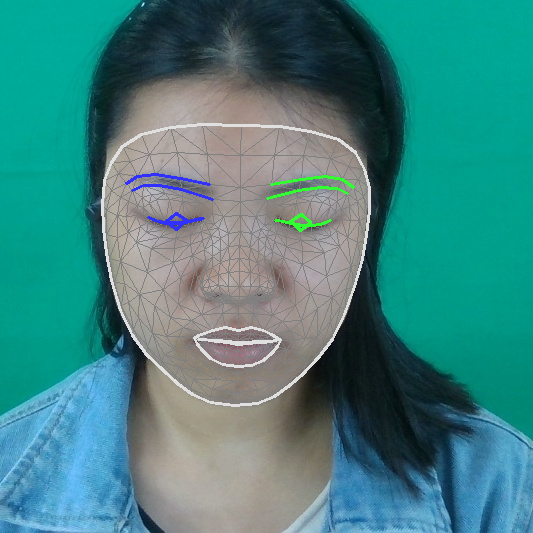

{'img9.jpg': {'browInnerUp': 0.1716793179512024, 'browOuterUpLeft': 0.13236746191978455, 'eyeLookDownLeft': 0.14801891148090363, 'eyeLookDownRight': 0.14949549734592438, 'eyeSquintLeft': 0.4661008417606354, 'eyeSquintRight': 0.36919909715652466, 'mouthPressRight': 0.12983199954032898}, 'img744.jpg': {'browInnerUp': 0.1004304587841034, 'browOuterUpLeft': 0.20178279280662537, 'browOuterUpRight': 0.1044047549366951, 'eyeBlinkLeft': 0.2302534580230713, 'eyeBlinkRight': 0.32938116788864136, 'eyeLookDownRight': 0.10570868849754333, 'eyeLookInRight': 0.19828230142593384, 'eyeLookOutLeft': 0.20405025780200958, 'eyeLookUpLeft': 0.1273510456085205, 'eyeLookUpRight': 0.1056172177195549, 'eyeSquintLeft': 0.6309655904769897, 'eyeSquintRight': 0.40485402941703796, 'mouthPucker': 0.38343706727027893}, 'img2222.jpg': {'browOuterUpLeft': 0.2936858534812927, 'browOuterUpRight': 0.18468357622623444, 'eyeBlinkLeft': 0.6929765343666077, 'eyeBlinkRight': 0.5651941299438477, 'eyeLookDownLeft': 0.712114930152

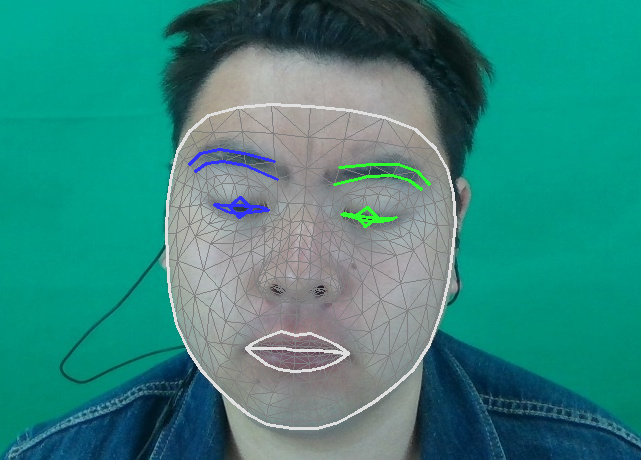

{'img9.jpg': {'browInnerUp': 0.1716793179512024, 'browOuterUpLeft': 0.13236746191978455, 'eyeLookDownLeft': 0.14801891148090363, 'eyeLookDownRight': 0.14949549734592438, 'eyeSquintLeft': 0.4661008417606354, 'eyeSquintRight': 0.36919909715652466, 'mouthPressRight': 0.12983199954032898}, 'img744.jpg': {'browInnerUp': 0.1004304587841034, 'browOuterUpLeft': 0.20178279280662537, 'browOuterUpRight': 0.1044047549366951, 'eyeBlinkLeft': 0.2302534580230713, 'eyeBlinkRight': 0.32938116788864136, 'eyeLookDownRight': 0.10570868849754333, 'eyeLookInRight': 0.19828230142593384, 'eyeLookOutLeft': 0.20405025780200958, 'eyeLookUpLeft': 0.1273510456085205, 'eyeLookUpRight': 0.1056172177195549, 'eyeSquintLeft': 0.6309655904769897, 'eyeSquintRight': 0.40485402941703796, 'mouthPucker': 0.38343706727027893}, 'img2222.jpg': {'browOuterUpLeft': 0.2936858534812927, 'browOuterUpRight': 0.18468357622623444, 'eyeBlinkLeft': 0.6929765343666077, 'eyeBlinkRight': 0.5651941299438477, 'eyeLookDownLeft': 0.712114930152

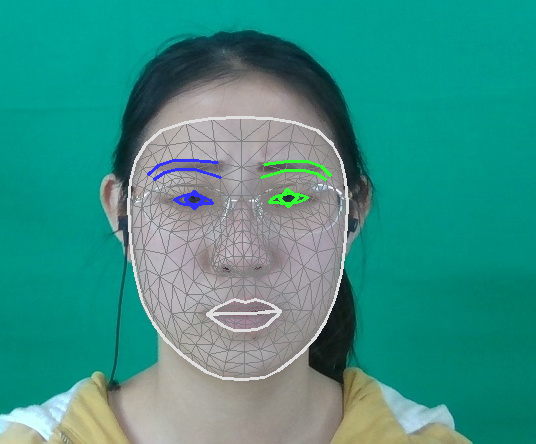

{'img9.jpg': {'browInnerUp': 0.1716793179512024, 'browOuterUpLeft': 0.13236746191978455, 'eyeLookDownLeft': 0.14801891148090363, 'eyeLookDownRight': 0.14949549734592438, 'eyeSquintLeft': 0.4661008417606354, 'eyeSquintRight': 0.36919909715652466, 'mouthPressRight': 0.12983199954032898}, 'img744.jpg': {'browInnerUp': 0.1004304587841034, 'browOuterUpLeft': 0.20178279280662537, 'browOuterUpRight': 0.1044047549366951, 'eyeBlinkLeft': 0.2302534580230713, 'eyeBlinkRight': 0.32938116788864136, 'eyeLookDownRight': 0.10570868849754333, 'eyeLookInRight': 0.19828230142593384, 'eyeLookOutLeft': 0.20405025780200958, 'eyeLookUpLeft': 0.1273510456085205, 'eyeLookUpRight': 0.1056172177195549, 'eyeSquintLeft': 0.6309655904769897, 'eyeSquintRight': 0.40485402941703796, 'mouthPucker': 0.38343706727027893}, 'img2222.jpg': {'browOuterUpLeft': 0.2936858534812927, 'browOuterUpRight': 0.18468357622623444, 'eyeBlinkLeft': 0.6929765343666077, 'eyeBlinkRight': 0.5651941299438477, 'eyeLookDownLeft': 0.712114930152

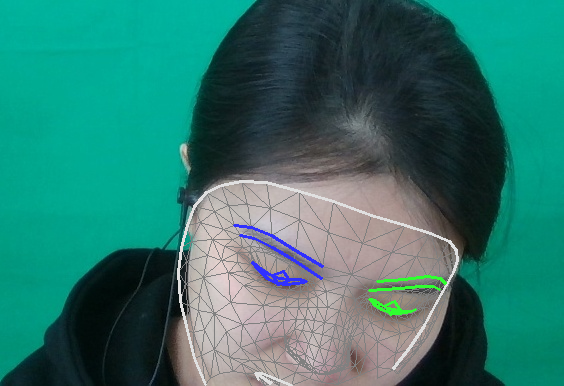

{'img9.jpg': {'browInnerUp': 0.1716793179512024, 'browOuterUpLeft': 0.13236746191978455, 'eyeLookDownLeft': 0.14801891148090363, 'eyeLookDownRight': 0.14949549734592438, 'eyeSquintLeft': 0.4661008417606354, 'eyeSquintRight': 0.36919909715652466, 'mouthPressRight': 0.12983199954032898}, 'img744.jpg': {'browInnerUp': 0.1004304587841034, 'browOuterUpLeft': 0.20178279280662537, 'browOuterUpRight': 0.1044047549366951, 'eyeBlinkLeft': 0.2302534580230713, 'eyeBlinkRight': 0.32938116788864136, 'eyeLookDownRight': 0.10570868849754333, 'eyeLookInRight': 0.19828230142593384, 'eyeLookOutLeft': 0.20405025780200958, 'eyeLookUpLeft': 0.1273510456085205, 'eyeLookUpRight': 0.1056172177195549, 'eyeSquintLeft': 0.6309655904769897, 'eyeSquintRight': 0.40485402941703796, 'mouthPucker': 0.38343706727027893}, 'img2222.jpg': {'browOuterUpLeft': 0.2936858534812927, 'browOuterUpRight': 0.18468357622623444, 'eyeBlinkLeft': 0.6929765343666077, 'eyeBlinkRight': 0.5651941299438477, 'eyeLookDownLeft': 0.712114930152

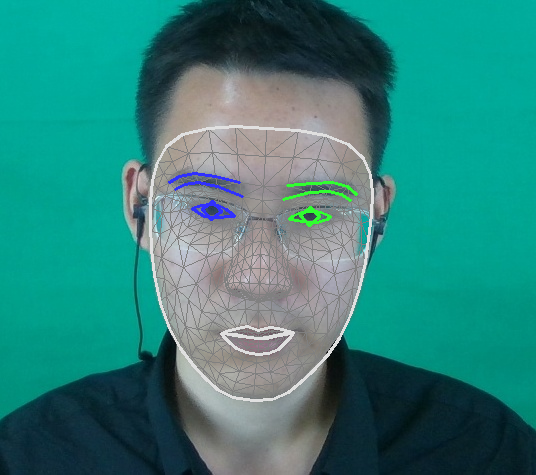

{'img9.jpg': {'browInnerUp': 0.1716793179512024, 'browOuterUpLeft': 0.13236746191978455, 'eyeLookDownLeft': 0.14801891148090363, 'eyeLookDownRight': 0.14949549734592438, 'eyeSquintLeft': 0.4661008417606354, 'eyeSquintRight': 0.36919909715652466, 'mouthPressRight': 0.12983199954032898}, 'img744.jpg': {'browInnerUp': 0.1004304587841034, 'browOuterUpLeft': 0.20178279280662537, 'browOuterUpRight': 0.1044047549366951, 'eyeBlinkLeft': 0.2302534580230713, 'eyeBlinkRight': 0.32938116788864136, 'eyeLookDownRight': 0.10570868849754333, 'eyeLookInRight': 0.19828230142593384, 'eyeLookOutLeft': 0.20405025780200958, 'eyeLookUpLeft': 0.1273510456085205, 'eyeLookUpRight': 0.1056172177195549, 'eyeSquintLeft': 0.6309655904769897, 'eyeSquintRight': 0.40485402941703796, 'mouthPucker': 0.38343706727027893}, 'img2222.jpg': {'browOuterUpLeft': 0.2936858534812927, 'browOuterUpRight': 0.18468357622623444, 'eyeBlinkLeft': 0.6929765343666077, 'eyeBlinkRight': 0.5651941299438477, 'eyeLookDownLeft': 0.712114930152

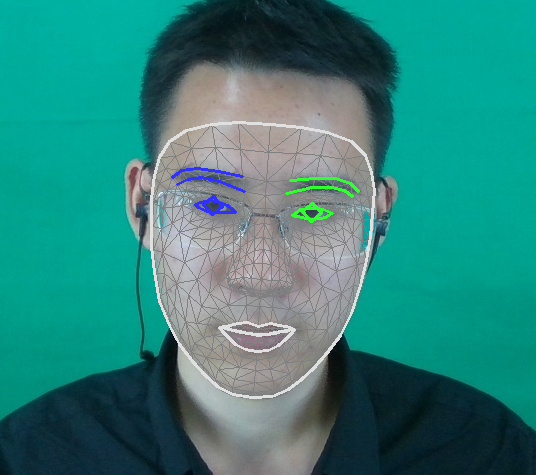

{'img9.jpg': {'browInnerUp': 0.1716793179512024, 'browOuterUpLeft': 0.13236746191978455, 'eyeLookDownLeft': 0.14801891148090363, 'eyeLookDownRight': 0.14949549734592438, 'eyeSquintLeft': 0.4661008417606354, 'eyeSquintRight': 0.36919909715652466, 'mouthPressRight': 0.12983199954032898}, 'img744.jpg': {'browInnerUp': 0.1004304587841034, 'browOuterUpLeft': 0.20178279280662537, 'browOuterUpRight': 0.1044047549366951, 'eyeBlinkLeft': 0.2302534580230713, 'eyeBlinkRight': 0.32938116788864136, 'eyeLookDownRight': 0.10570868849754333, 'eyeLookInRight': 0.19828230142593384, 'eyeLookOutLeft': 0.20405025780200958, 'eyeLookUpLeft': 0.1273510456085205, 'eyeLookUpRight': 0.1056172177195549, 'eyeSquintLeft': 0.6309655904769897, 'eyeSquintRight': 0.40485402941703796, 'mouthPucker': 0.38343706727027893}, 'img2222.jpg': {'browOuterUpLeft': 0.2936858534812927, 'browOuterUpRight': 0.18468357622623444, 'eyeBlinkLeft': 0.6929765343666077, 'eyeBlinkRight': 0.5651941299438477, 'eyeLookDownLeft': 0.712114930152

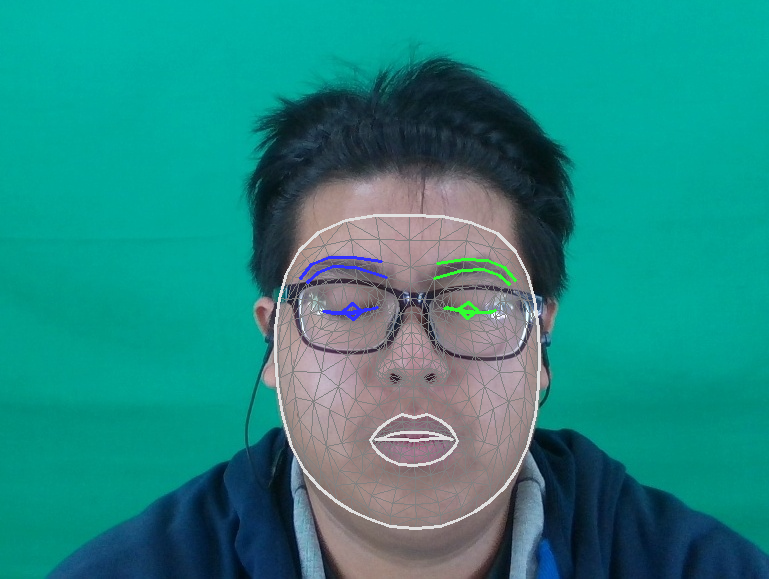

{'img9.jpg': {'browInnerUp': 0.1716793179512024, 'browOuterUpLeft': 0.13236746191978455, 'eyeLookDownLeft': 0.14801891148090363, 'eyeLookDownRight': 0.14949549734592438, 'eyeSquintLeft': 0.4661008417606354, 'eyeSquintRight': 0.36919909715652466, 'mouthPressRight': 0.12983199954032898}, 'img744.jpg': {'browInnerUp': 0.1004304587841034, 'browOuterUpLeft': 0.20178279280662537, 'browOuterUpRight': 0.1044047549366951, 'eyeBlinkLeft': 0.2302534580230713, 'eyeBlinkRight': 0.32938116788864136, 'eyeLookDownRight': 0.10570868849754333, 'eyeLookInRight': 0.19828230142593384, 'eyeLookOutLeft': 0.20405025780200958, 'eyeLookUpLeft': 0.1273510456085205, 'eyeLookUpRight': 0.1056172177195549, 'eyeSquintLeft': 0.6309655904769897, 'eyeSquintRight': 0.40485402941703796, 'mouthPucker': 0.38343706727027893}, 'img2222.jpg': {'browOuterUpLeft': 0.2936858534812927, 'browOuterUpRight': 0.18468357622623444, 'eyeBlinkLeft': 0.6929765343666077, 'eyeBlinkRight': 0.5651941299438477, 'eyeLookDownLeft': 0.712114930152

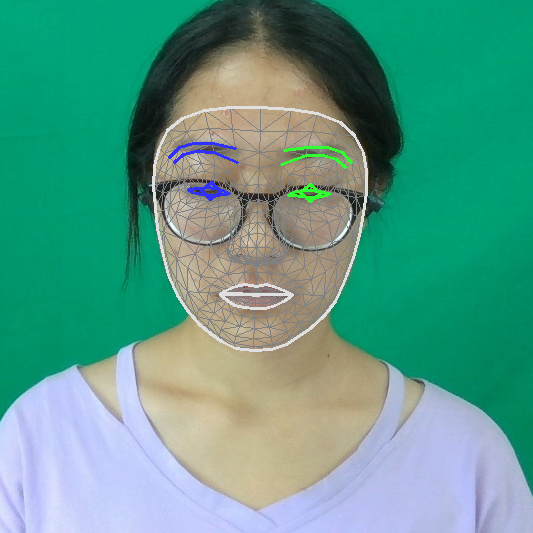

{'img9.jpg': {'browInnerUp': 0.1716793179512024, 'browOuterUpLeft': 0.13236746191978455, 'eyeLookDownLeft': 0.14801891148090363, 'eyeLookDownRight': 0.14949549734592438, 'eyeSquintLeft': 0.4661008417606354, 'eyeSquintRight': 0.36919909715652466, 'mouthPressRight': 0.12983199954032898}, 'img744.jpg': {'browInnerUp': 0.1004304587841034, 'browOuterUpLeft': 0.20178279280662537, 'browOuterUpRight': 0.1044047549366951, 'eyeBlinkLeft': 0.2302534580230713, 'eyeBlinkRight': 0.32938116788864136, 'eyeLookDownRight': 0.10570868849754333, 'eyeLookInRight': 0.19828230142593384, 'eyeLookOutLeft': 0.20405025780200958, 'eyeLookUpLeft': 0.1273510456085205, 'eyeLookUpRight': 0.1056172177195549, 'eyeSquintLeft': 0.6309655904769897, 'eyeSquintRight': 0.40485402941703796, 'mouthPucker': 0.38343706727027893}, 'img2222.jpg': {'browOuterUpLeft': 0.2936858534812927, 'browOuterUpRight': 0.18468357622623444, 'eyeBlinkLeft': 0.6929765343666077, 'eyeBlinkRight': 0.5651941299438477, 'eyeLookDownLeft': 0.712114930152

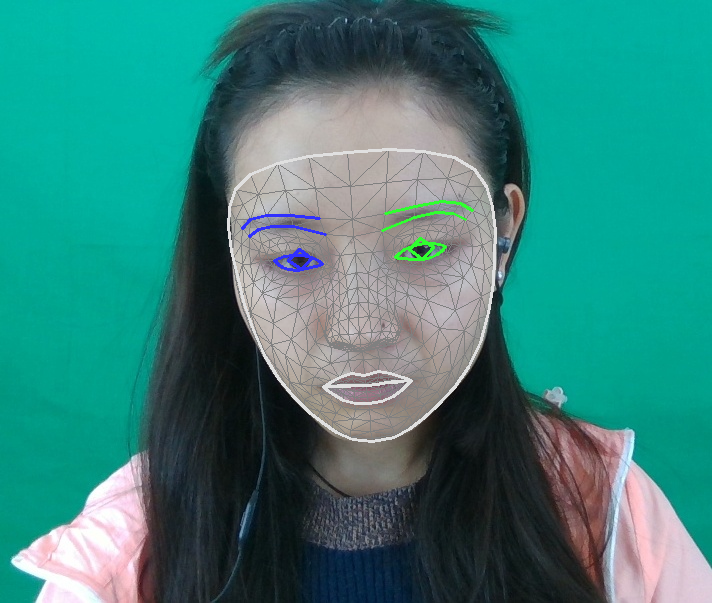

{'img9.jpg': {'browInnerUp': 0.1716793179512024, 'browOuterUpLeft': 0.13236746191978455, 'eyeLookDownLeft': 0.14801891148090363, 'eyeLookDownRight': 0.14949549734592438, 'eyeSquintLeft': 0.4661008417606354, 'eyeSquintRight': 0.36919909715652466, 'mouthPressRight': 0.12983199954032898}, 'img744.jpg': {'browInnerUp': 0.1004304587841034, 'browOuterUpLeft': 0.20178279280662537, 'browOuterUpRight': 0.1044047549366951, 'eyeBlinkLeft': 0.2302534580230713, 'eyeBlinkRight': 0.32938116788864136, 'eyeLookDownRight': 0.10570868849754333, 'eyeLookInRight': 0.19828230142593384, 'eyeLookOutLeft': 0.20405025780200958, 'eyeLookUpLeft': 0.1273510456085205, 'eyeLookUpRight': 0.1056172177195549, 'eyeSquintLeft': 0.6309655904769897, 'eyeSquintRight': 0.40485402941703796, 'mouthPucker': 0.38343706727027893}, 'img2222.jpg': {'browOuterUpLeft': 0.2936858534812927, 'browOuterUpRight': 0.18468357622623444, 'eyeBlinkLeft': 0.6929765343666077, 'eyeBlinkRight': 0.5651941299438477, 'eyeLookDownLeft': 0.712114930152

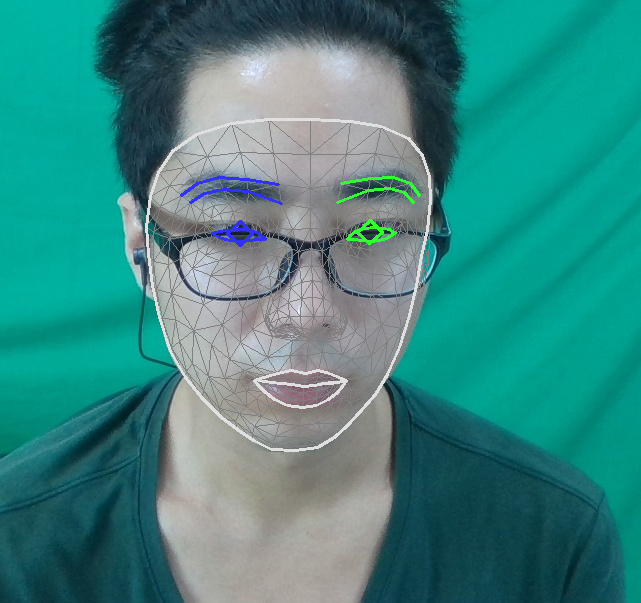

{'img9.jpg': {'browInnerUp': 0.1716793179512024, 'browOuterUpLeft': 0.13236746191978455, 'eyeLookDownLeft': 0.14801891148090363, 'eyeLookDownRight': 0.14949549734592438, 'eyeSquintLeft': 0.4661008417606354, 'eyeSquintRight': 0.36919909715652466, 'mouthPressRight': 0.12983199954032898}, 'img744.jpg': {'browInnerUp': 0.1004304587841034, 'browOuterUpLeft': 0.20178279280662537, 'browOuterUpRight': 0.1044047549366951, 'eyeBlinkLeft': 0.2302534580230713, 'eyeBlinkRight': 0.32938116788864136, 'eyeLookDownRight': 0.10570868849754333, 'eyeLookInRight': 0.19828230142593384, 'eyeLookOutLeft': 0.20405025780200958, 'eyeLookUpLeft': 0.1273510456085205, 'eyeLookUpRight': 0.1056172177195549, 'eyeSquintLeft': 0.6309655904769897, 'eyeSquintRight': 0.40485402941703796, 'mouthPucker': 0.38343706727027893}, 'img2222.jpg': {'browOuterUpLeft': 0.2936858534812927, 'browOuterUpRight': 0.18468357622623444, 'eyeBlinkLeft': 0.6929765343666077, 'eyeBlinkRight': 0.5651941299438477, 'eyeLookDownLeft': 0.712114930152

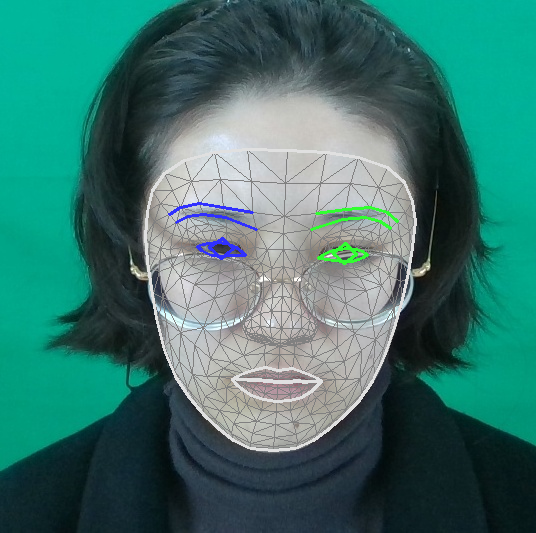

{'img9.jpg': {'browInnerUp': 0.1716793179512024, 'browOuterUpLeft': 0.13236746191978455, 'eyeLookDownLeft': 0.14801891148090363, 'eyeLookDownRight': 0.14949549734592438, 'eyeSquintLeft': 0.4661008417606354, 'eyeSquintRight': 0.36919909715652466, 'mouthPressRight': 0.12983199954032898}, 'img744.jpg': {'browInnerUp': 0.1004304587841034, 'browOuterUpLeft': 0.20178279280662537, 'browOuterUpRight': 0.1044047549366951, 'eyeBlinkLeft': 0.2302534580230713, 'eyeBlinkRight': 0.32938116788864136, 'eyeLookDownRight': 0.10570868849754333, 'eyeLookInRight': 0.19828230142593384, 'eyeLookOutLeft': 0.20405025780200958, 'eyeLookUpLeft': 0.1273510456085205, 'eyeLookUpRight': 0.1056172177195549, 'eyeSquintLeft': 0.6309655904769897, 'eyeSquintRight': 0.40485402941703796, 'mouthPucker': 0.38343706727027893}, 'img2222.jpg': {'browOuterUpLeft': 0.2936858534812927, 'browOuterUpRight': 0.18468357622623444, 'eyeBlinkLeft': 0.6929765343666077, 'eyeBlinkRight': 0.5651941299438477, 'eyeLookDownLeft': 0.712114930152

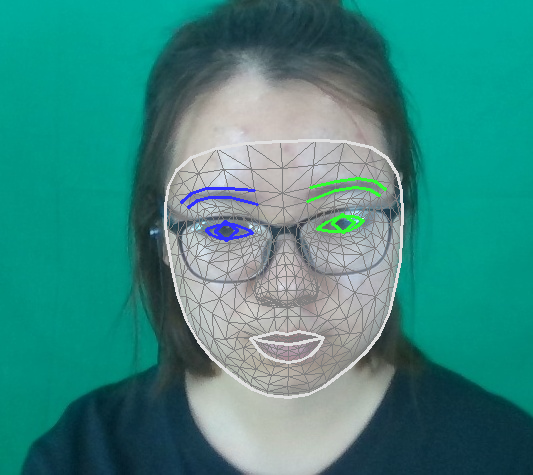

{'img9.jpg': {'browInnerUp': 0.1716793179512024, 'browOuterUpLeft': 0.13236746191978455, 'eyeLookDownLeft': 0.14801891148090363, 'eyeLookDownRight': 0.14949549734592438, 'eyeSquintLeft': 0.4661008417606354, 'eyeSquintRight': 0.36919909715652466, 'mouthPressRight': 0.12983199954032898}, 'img744.jpg': {'browInnerUp': 0.1004304587841034, 'browOuterUpLeft': 0.20178279280662537, 'browOuterUpRight': 0.1044047549366951, 'eyeBlinkLeft': 0.2302534580230713, 'eyeBlinkRight': 0.32938116788864136, 'eyeLookDownRight': 0.10570868849754333, 'eyeLookInRight': 0.19828230142593384, 'eyeLookOutLeft': 0.20405025780200958, 'eyeLookUpLeft': 0.1273510456085205, 'eyeLookUpRight': 0.1056172177195549, 'eyeSquintLeft': 0.6309655904769897, 'eyeSquintRight': 0.40485402941703796, 'mouthPucker': 0.38343706727027893}, 'img2222.jpg': {'browOuterUpLeft': 0.2936858534812927, 'browOuterUpRight': 0.18468357622623444, 'eyeBlinkLeft': 0.6929765343666077, 'eyeBlinkRight': 0.5651941299438477, 'eyeLookDownLeft': 0.712114930152

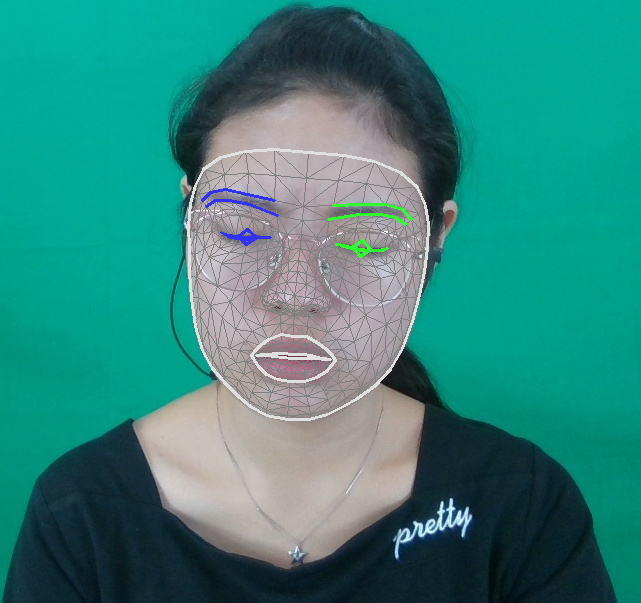

{'img9.jpg': {'browInnerUp': 0.1716793179512024, 'browOuterUpLeft': 0.13236746191978455, 'eyeLookDownLeft': 0.14801891148090363, 'eyeLookDownRight': 0.14949549734592438, 'eyeSquintLeft': 0.4661008417606354, 'eyeSquintRight': 0.36919909715652466, 'mouthPressRight': 0.12983199954032898}, 'img744.jpg': {'browInnerUp': 0.1004304587841034, 'browOuterUpLeft': 0.20178279280662537, 'browOuterUpRight': 0.1044047549366951, 'eyeBlinkLeft': 0.2302534580230713, 'eyeBlinkRight': 0.32938116788864136, 'eyeLookDownRight': 0.10570868849754333, 'eyeLookInRight': 0.19828230142593384, 'eyeLookOutLeft': 0.20405025780200958, 'eyeLookUpLeft': 0.1273510456085205, 'eyeLookUpRight': 0.1056172177195549, 'eyeSquintLeft': 0.6309655904769897, 'eyeSquintRight': 0.40485402941703796, 'mouthPucker': 0.38343706727027893}, 'img2222.jpg': {'browOuterUpLeft': 0.2936858534812927, 'browOuterUpRight': 0.18468357622623444, 'eyeBlinkLeft': 0.6929765343666077, 'eyeBlinkRight': 0.5651941299438477, 'eyeLookDownLeft': 0.712114930152

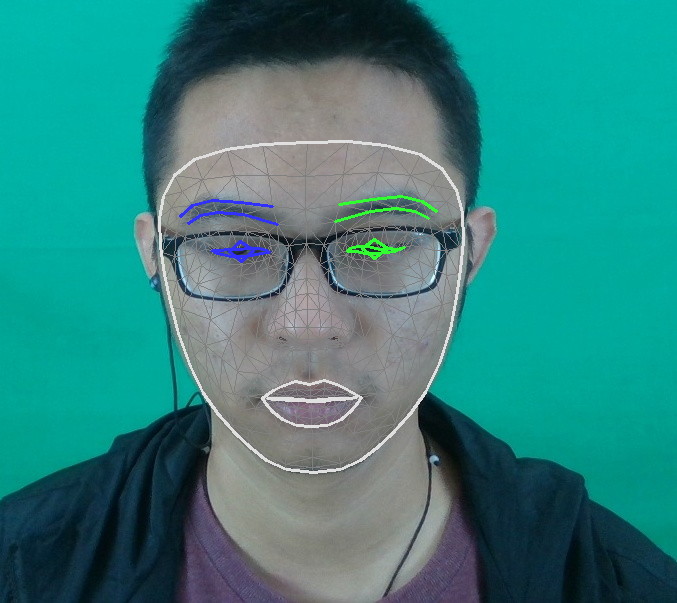

{'img9.jpg': {'browInnerUp': 0.1716793179512024, 'browOuterUpLeft': 0.13236746191978455, 'eyeLookDownLeft': 0.14801891148090363, 'eyeLookDownRight': 0.14949549734592438, 'eyeSquintLeft': 0.4661008417606354, 'eyeSquintRight': 0.36919909715652466, 'mouthPressRight': 0.12983199954032898}, 'img744.jpg': {'browInnerUp': 0.1004304587841034, 'browOuterUpLeft': 0.20178279280662537, 'browOuterUpRight': 0.1044047549366951, 'eyeBlinkLeft': 0.2302534580230713, 'eyeBlinkRight': 0.32938116788864136, 'eyeLookDownRight': 0.10570868849754333, 'eyeLookInRight': 0.19828230142593384, 'eyeLookOutLeft': 0.20405025780200958, 'eyeLookUpLeft': 0.1273510456085205, 'eyeLookUpRight': 0.1056172177195549, 'eyeSquintLeft': 0.6309655904769897, 'eyeSquintRight': 0.40485402941703796, 'mouthPucker': 0.38343706727027893}, 'img2222.jpg': {'browOuterUpLeft': 0.2936858534812927, 'browOuterUpRight': 0.18468357622623444, 'eyeBlinkLeft': 0.6929765343666077, 'eyeBlinkRight': 0.5651941299438477, 'eyeLookDownLeft': 0.712114930152

In [ ]:
# STEP 3: Load the input image.

# get the path/directory
folder_dir = "/content/fear"
for images in os.listdir(folder_dir):

    # check if the image ends with png
    if (images.endswith(".jpg")):
        IMAGE_FILE = "/content/fear/" + images
        image = mp.Image.create_from_file(IMAGE_FILE)
        # STEP 4: Detect face landmarks from the input image.
        detection_result = detector.detect(image)
        # STEP 5: Process the detection result. In this case, visualize it.

        annotated_image = draw_landmarks_on_image(image.numpy_view(), detection_result)
        cv2_imshow(cv2.cvtColor(annotated_image, cv2.COLOR_RGB2BGR))


        results = detection_result.face_blendshapes[0]
        newValues = []
        num = 0.10
        for x in results:
            name = x.category_name
            score = x.score
            if score >= num:
              newValues += name, score
       #make new list to separate floats from strings
        floats = []
        for value in newValues:
          if type(value) == float:
            floats.append(value)
            newValues.remove(value)
        #make dictionary
        newDict = {newValues[i] : floats[i] for i in range(len(newValues))}
        fear['img' + images] = newDict
        print(fear)

###Get blendshapes results


85.j


In [ ]:
results = detection_result.face_blendshapes[0]

###Make list with values of most active blenshapes

In [ ]:
newValues = []
num = 0.10
for x in results:
  name = x.category_name
  score = x.score
  if score >= num:
    newValues += name, score


In [ ]:
print(newValues)

['eyeBlinkLeft', 0.2081683725118637, 'eyeBlinkRight', 0.19045168161392212, 'eyeLookDownLeft', 0.3304685950279236, 'eyeLookDownRight', 0.3039871156215668, 'eyeLookInLeft', 0.11770942807197571, 'eyeSquintLeft', 0.42177721858024597, 'eyeSquintRight', 0.42692831158638, 'mouthPressLeft', 0.11675459146499634, 'mouthPressRight', 0.14381398260593414]


In [ ]:
#make new list to separate floats from strings
floats = []

for value in newValues:
  if type(value) == float:
    floats.append(value)
    newValues.remove(value)

In [ ]:
#check if values are correct
print(floats)
print(newValues)

[0.2081683725118637, 0.19045168161392212, 0.3304685950279236, 0.3039871156215668, 0.11770942807197571, 0.42177721858024597, 0.42692831158638, 0.11675459146499634, 0.14381398260593414]
['eyeBlinkLeft', 'eyeBlinkRight', 'eyeLookDownLeft', 'eyeLookDownRight', 'eyeLookInLeft', 'eyeSquintLeft', 'eyeSquintRight', 'mouthPressLeft', 'mouthPressRight']


###Make dictionary containing new values in order to convert to JSON or CSV

In [ ]:
newDict = {newValues[i] : floats[i] for i in range(len(newValues))}

14


In [ ]:
happy['img' + IMAGE_FILE[0:3]] = newDict
print(happy)

NameError: ignored

###Convert to JSON, save in separate json file ❄

In [ ]:
import json

json_object = json.dumps(anger, indent = 4)
print(json_object)


{
    "img1846.jpg": {
        "browInnerUp": 0.14294612407684326,
        "browOuterUpLeft": 0.1066095232963562,
        "browOuterUpRight": 0.17994169890880585,
        "eyeBlinkLeft": 0.19700628519058228,
        "eyeLookInRight": 0.3883419334888458,
        "eyeLookOutLeft": 0.38975897431373596,
        "eyeLookUpLeft": 0.2965420186519623,
        "eyeLookUpRight": 0.3052882254123688,
        "eyeSquintLeft": 0.5203642249107361,
        "eyeSquintRight": 0.4510556757450104,
        "mouthLeft": 0.27681764960289,
        "mouthPucker": 0.1638011485338211
    },
    "img2245.jpg": {
        "browDownLeft": 0.1271161139011383,
        "browDownRight": 0.12941819429397583,
        "eyeBlinkLeft": 0.22812579572200775,
        "eyeBlinkRight": 0.22565937042236328,
        "eyeLookInRight": 0.13169068098068237,
        "eyeLookOutLeft": 0.17998909950256348,
        "eyeLookUpLeft": 0.27032941579818726,
        "eyeLookUpRight": 0.2473270297050476,
        "eyeSquintLeft": 0.57320666313171

In [ ]:
#store data in a new json file -- make file before running
with open("anger.json", "w") as outfile:
    outfile.write(json_object)

In [ ]:
#initialize once
happy = {}